# Assessment - Forklift Data Set Analyses

In this notebook we will be focusing on the analyses of the provided `use_case_image_set` which contains a number of images which contain an assortment of people, a forklift and objects of interest.

For the sake of brevity the training of this


# Prerequisites

You'll need the following Python libraries:
- `numpy`: For numerical operations.
- `math`: For calculations involving angles.
- `plotly`: For interactive visualizations.
- `ultralytics` for the YOLOv8(.2) model infrastructure and evaluation.

In [ ]:
!pip install numpy plotly opencv-contrib-python ultralytics supervision

## Confirmation everything is installed

In [ ]:
import numpy
import plotly
import ultralytics
import cv2
import supervision as sv

print(f"numpy version installed: {numpy.__version__}")
print(f"plotly version installed: {plotly.__version__}")
print(f"ultralytics version installed: {ultralytics.__version__}")
print(f"opencv version installed: {cv2.__version__}")
print(f"supervision version installed: {sv.__version__}")

numpy version installed: 1.26.4
plotly version installed: 5.15.0
ultralytics version installed: 8.2.82
opencv version installed: 4.10.0
supervision version installed: 0.22.0


## Download data

NOTE: If the following cell is not run then some of the cells later on in this notebook will not work. If any cells are run it is best to run all of them, except any in the "Training" section (they can still be run but would consume more time).

In [ ]:
!rm -rf matrix-assessment
!git clone https://github.com/Xirious/matrix-assessment.git
!cd matrix-assessment

Cloning into 'matrix-assessment'...
remote: Enumerating objects: 2274, done.
remote: Counting objects: 100% (556/556), done.
remote: Compressing objects: 100% (549/549), done.
remote: Total 2274 (delta 8), reused 552 (delta 6), pack-reused 1718 (from 1)
Receiving objects: 100% (2274/2274), 432.28 MiB | 35.52 MiB/s, done.
Resolving deltas: 100% (18/18), done.
Updating files: 100% (2226/2226), done.


## Check home folder access

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


# Trainings and tribulations

The data did not come with labelled samples and thus to be of any use for training (at least in a supervised manner) it would need to be labelled either automatically (using a tool like AutoML or Autodistill, discussed next) or hand-labelled.

Parallel to the labelling and in support of it, the dataset was assessed along a number of typical dataset characteristics. This helped inform the labelling but could also provide direction for future avenues of work with this or other similar data.

#### A note on unsupervised training
Additionally, we could employ some unsupervised techniques to assess the data to identify patterns and features but given the size constraint of the image data (only 228 frames) there was deemed insufficent data to make this direction viable.

## Autodistill

[Autodistill](https://github.com/autodistill/autodistill) and its ilk like [AutoML](https://arxiv.org/abs/2402.18198) are great tools to help ease the burden of labelling which is always a cumbersome part of machine learning. In essence they use large foundational models and prompts and other guiding data to help automatically label data. For a few cases in the past this has helped myself greatly in quickly labeling simpler scenes with one or two different classes that are well known to the classifiers.

In this case the initial results provided by Autodistill did not have the required repeatability or accuracy that was required for this dataset. I suspect the limited training time and pre-processing (I did not do yet) before being given to the model played a large role in the less than stellar accuracy. Given more time to refine what the model sees and a bit more GPU processing time I believe this would be a viable approach. However, for this project it was deemed faster to hand-label the dataset with sufficient accuracy and use that as the basis going forward for this.

## Hand labelling

Hand-labelling is often a tedious process and even with tools like AutoDistill it often ends up that you will still need to do some portion of labelling if only to provide various models with few-shot examples. Towards this end I used a tool quite familiar to myself to prepare the data in a format that could easily be converted into something that could be read by ML tools like pytorch and/or tensorflow.

### CVAT

The Computer Vision Annotation Tool (CVAT) is one of the most useful tools in the arsenal of a Computer Vision expert. It focuses primarily on image and video annotations, offering tools specifically designed for detailed tasks in these areas. With functionalities like 3D Object Annotation, Annotation with Polygons, and Skeleton Annotation, CVAT is tailored for projects that need depth and precision in visual data which aligned well with task at hand.

![CVAT](https://i.imgur.com/AZF9rbx.png)

### Hosting CVAT
There is a ["free" online version of CVAT](https://app.cvat.ai/auth/login) however it does not let a user exmport their data (or this sized dataset even) without a paid version. However, CVAT itself is a [long-running open-source tool](https://github.com/cvat-ai/cvat) and getting it to run locally was quite trivial as they provide a `docker-compose` file to run the service. From there it was about loading the data, labelling it and exporting it.

### Labelling this dataset
Above shows an example of one of the dataset frames that was labelled using CVAT. Some points to note:
- CVAT allows you to move forward and backward quite easily between images. This allows one to label successive images with little to no movement for given objects quite accurately.
- As a note I originally started labelling some of the data with _rotated_ bounding boxes. Given the angle and direction of the camera this made some sense, particularly for objects of interest like the truss while it is against the pillar at the start of the data. To accurately do this, though, within the time constraints did not seem like a viable use of my time and I ended up going with rectangular only bounding boxes. For the case where the truss is laid flat I simply adjusted the dimensions of the bounding box. This had the added benefit that if I wanted to define different behaviour of the truss I could do so simply by looking at the ratio of the dimensions.
- The above implied that precise description of the truss would be more complex with this dataset. However, given the goals of the assessment (identify forklift and its behaviour and identification of other objects as secondary) the above was an acceptable compromise.
- The greatest accuracy of labelling fit was paid to the forklift as it was the primary focus for the assessement. The bounding boxes were kept as tight as possible around the base of the forklift up to and including the start of the telescopic extension.
- One aspect of the forklift that was not labelled was the telescoping extension of the forklift. The primary reason behind this was a limit on time but one problem with including the telescoping part would make the comparison of the distance from the camera difficult and relative sizes of the forklift between frames quite far apart would not align. For the sake of simplicity the more rigid parts of the forklift were the only ones labelled.
- Most models are already trained on humans so the labelling of humans had less accuracy. One thing to note is that labelling did include the "shape" of the human given the view from the camera. For example, the visible part of the human in the forklift would be square and not rectangular.
- Objects of intrest across the frames that were labelled include the full truss standing up and being layed down, the two pieces of cardboard used to lay the truss on the ground, and the blue wooden crates being carried in and out of the frame.

### Exporting format - COCO vs YOLO v1 vs YOLO v5/v8.
Post labelling the dataset was exported using the COCO dataset format. This is a generally widely used format for Computer Vision data.

One of the primary issues faced later on in the development of this assignment was that COCO was not a compatible format for the YOLOv8 detector that was chosen. To this end it uses YOLOv5 or v8 to read in and train the detector. CVAT can export in YOLOv1 but that is a text based format somewhat different to the v5/v8. At the time of this assessment, CVAT did not have support [for exporting the data in the YOLOv5 + Pytorch spec](https://github.com/ultralytics/yolov5/issues/12759). So to solve this either a converter needed to be created or another tool used.

To this end the dataset was imported into [Roboflow](https://roboflow.com/) which does allow for exporting of the data into YOLOv5 + pytorch (`data.yaml`). This is the format that is used in the training of the model.

An additional benefit to using roboflow is that they allow for pre-processing and data augmentations as steps before the data is exported. This aligns well with the training step.

## Dataset assessment

One of the first steps in a successful computer vision project is to ensure that your model will perform in real-world scenarios. Given that the current dataset is quite limited and the application beyond the assessment is unknown some of these will not be applicable. However, to ensure the best possible quality of the data the model is trained with many of these steps were taken into account.

### Note on dataset analytics using Roboflow
From the imported data from CVAT Roboflow allows us to analyse the basics of the dataset before any preprocessing or data augmentation. Whilst this analysis could have been performed by hand and python given the annotations my philosophy is if there is a tool that can do it easier one should use that tool.

### 1. **Dataset Diversity and Representativeness**
   - **Class Distribution**: Across the dataset there were at least two different classes - the `forklift` and `human` classes. Given the description of the assessment a third class was added - objects of interest (`objectofinterest` in data). The class makeup in the end was quite unbalanced - there were numerous examples of humans walking in and out of the image and numerous examples of the objects of interest but far fewer examples of the forklift.
   - **Intra-Class Variation**: The variations within the classes were as follows:
     - The forklift had distance (and thus size) differences as the forklift moved around. This also translated into some differences in the angle of the forklift relative to the camera. Due to their only being one (fully) visible forklift there was not multiple version of the forklift to train on. Additionally, the forklift is occluded by humans and objects of interest.
     - The humans in the image had multiple differences across them some in various directions, distances from the camera and in various clothes. This includes multiple forms of occulusions including other humans and objects of interest.
     - The intra-class variations for the objects of interest varied. The two pieces of cardboard had the least variations, only being rotated once or twice in the whole dataset. The truss had significant inter-class variances as it changes relative shape quite significantly across the entire dataset. It has the fewest occulusions of any of the classes because who wants to get in front of that thing. Finally, the wooden crates also had multiple intra-class variance as it takes multiple shapes from lying on the floor to being carried in and out of the frame. Huamns and the truss often occulude them as well.
     - All of the objects had fairly consistent lighting as the camera was fixed into a specific position and the lighting is typically controlled in these warehouse situations.
   
   - **Inter-Class Similarity**: The classes themselves were quite dissimilar - particularly humans do not look like objects which do not look like the forklift. This model should have little difficulty separating these classes with enough training.
   - **Geographical and Demographic Diversity**: As there was no other locations in the video the dataset did not inherently include variation in geographical diversity. However, there was some variations in the demographic/ethencities available in the data. Given that the goal of the assessment is to detect the forklift and its behaviour this was an acceptable level of diversity here.

### 2. **Data Quality**
   - **Image Resolution and Quality**: The images were tall (1080 x 1920) images of high quality. This allowed for visiblity of the objects of interest, humans and forklift in great detail. Given that there was no requirement on the
   High-resolution images are often better, but consider the trade-off between resolution and computational requirements.
   - **Noise and Artifacts**: The images do not appear to contain noise, compression artifacts, or other imperfections that could affect model performance.

### 3. **Data Balance**
   - **Class Balance**: As mentioned previously the dataset is not balanced. In particular the forklift is under-represented.

   ![dataset-analyses](https://i.imgur.com/okxiqwQ.png)

   The imbalance of the data set could be overcome by using techniques such as oversampling or weighted loss functions.
   - **Temporal or Spatial Balance**: The dataset inlcudes sequences (e.g., video frames) and thus needs to capture balanced spatial information. However, given no additional information the details of the rate of capture is difficult to accertain.

### 4. **Annotation Quality**
   - Given that the dataset came with no annotated data assessing the quality of the **Bounding Box Accuracy** is not explicitly feasible without something like a double blind test or using a external labelling service and comparing the results. Given the time constraints an implicit assessment using a training/validation and testing set is the current best course of action. Similarly, the **Label Accuracy** is assessed using a confusion matrix and precision/recall values.

### 5. **Dataset Size**
   - **Sufficiency**: Ensuring the dataset is large enough to train a robust model is one of the most difficult parts of the Computer Vision process. Given the small dataset size the dataset may not be sufficient to properly fine tune the model chosen.
      - The dataset contained a total of 228 images. For wide applications that would certainly not be enough to train many systems. To this end it was decided that rather than train a model from scratch a model would be fine-tuned. See the "Model selection" section of the "Training" for more details.  
   - **Scalability**: The dataset can be expanded in the future and there are likely additional datasets that could be used. However, the focus was on understanding just how far this dataset could be taken to fine tune a model. Scalability could be examined as a follow up step.

### 6. **Edge Cases and Corner Cases**
   - With this single dataset finding **Rare Classes** and **Adversarial Samples** was not a high priority. In real-world scenarios these become defining characteristics that your model needs to deal with and hence it would be a vital part of the development of the system but in this case time did not permit these additional cases to be found.
   - **Challenging Conditions**: The challenges in the dataset is mostly from occlusions and a somewhat unsual angle. While likely not representative of a real-world scenario for the detection of hazardous events the dataset does contain some more challenging conditions.

### 7. **Domain Relevance**
   - **Domain-Specific Variability**: The dataset does not include the specific variations relevant to your application domain as it is a single video for a specific time period and no other camera angles. More specifically, it only includes a single example of a forklift of which there are many variations in the world. To make this work applicable in real-world scenarios the domain specific variablility would need to be increased.

### 8. **Ethical Considerations**
   - **Bias and Fairness**: Given the dataset considerations above it does not appear that there are potential issues that lead to unfair treatment of certain groups.
   - **Privacy and Consent**: The dataset is assumed to be a [public dataset](https://www.pexels.com/video/workers-at-a-warehouse-15170997/) and the assumption is that the video distributor is adhering to privacy laws and that data collection was done ethically, with appropriate consent.

### 9. **Dataset Splitting**
   - **Train/Validation/Test Split**: The data was split into a 60%/20%/20%. The idea behind this was that validation should represent a reasonably similiar approximation of the test set. Additionally, the training data should almost always represent the bulk of the data.
  ![training split](https://i.imgur.com/1Sl5ghe.png)
  ![validation split](https://i.imgur.com/T0fqZbv.png)
  ![testing split](https://i.imgur.com/ym7ScV0.png)

   - **Stratification**: Stratified sample splitting was considered to maintain class balance across splits and is particularly useful for imbalanced datasets. This, however, would only be done if the performance of the model appeared to performing badly in a way that would negatively impact the operation of teh system.

Using the above I was able to address potential issues early on and steps to address them. Examples of this include:
- Identifying that the data would likely require some data preprocessing to ensure that the model can train quickly given the time available.
- There is definitely a need for data augmentation.
- Annotations for specific classes were of utmost importance and so relying on tools such as Autodistill may reduce overall accuracy and effectiveness of whichever model is selected.


### Visualisation of the dataset

#### Random samples

image count: 228


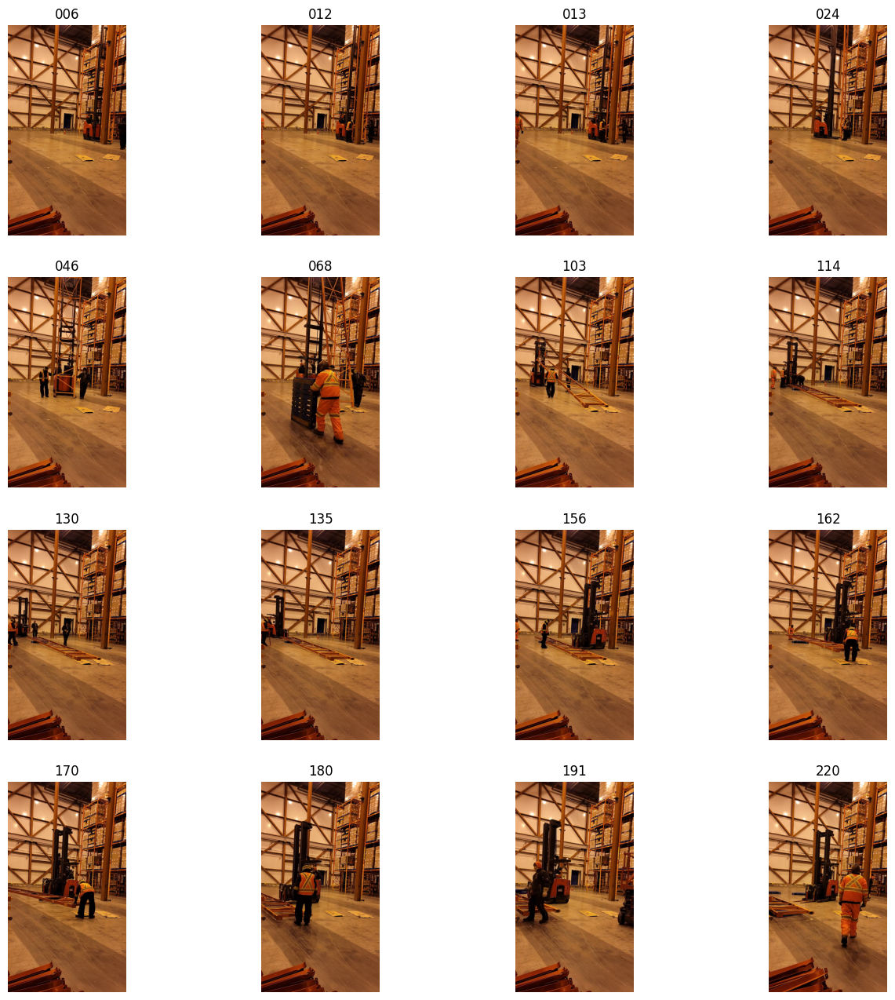

In [ ]:
from random import sample

IMAGE_DIR_PATH = f"{HOME}/matrix-assessment/dataset_full"
SAMPLE_SIZE = 16
SAMPLE_GRID_SIZE = (4, 4)
SAMPLE_PLOT_SIZE = (16, 16)

image_paths = sv.list_files_with_extensions(
    directory=IMAGE_DIR_PATH,
    extensions=["jpg"])

print('image count:', len(image_paths))

image_paths = sorted(image_paths)

image_paths_sampled = sample(image_paths,SAMPLE_SIZE)
image_paths_sampled = sorted(image_paths_sampled)

titles = []
images = []
for image_path in image_paths_sampled:
  titles.append(image_path.stem[-3:])
  images.append(cv2.imread(str(image_path)))

sv.plot_images_grid(images=images, titles=titles, grid_size=SAMPLE_GRID_SIZE, size=SAMPLE_PLOT_SIZE)

# Training

> **_NOTE:_**  Do not ***run*** the following pieces of code unless you are willing to wait for the training model to finish and evaluation to happen. The trained model is stored in the accompanying github repository.

## Model/tool selection

When choosing an object detection model, I focus on several crucial factors to ensure the model aligns with my project needs:

**Accuracy and Performance**: I assess the model’s precision and recall, and review its performance on benchmark datasets to ensure it delivers high accuracy for my specific task. With a custom model it is difficult to know its performance across a range of tasks beforehand but with pre-trained models such as YOLOv8/SSD (Single Shot MultiBox Detector)/Faster R-CNN there are ample examples of how each of these perform across various tasks.

**Speed and Efficiency**: I consider how quickly the model can make predictions and its resource requirements. A model that operates efficiently and quickly is important for real-time applications. Given there is no _real_ requirement in this assessment for this I lowered the priority on this but it is a very important consideration when looking at real-world applications. In a number of applications I've encountered custom models can by hyper-specialised for the task at hand and tend to be much better at specialised scenarious when considering speed.

**Ease of Use**: Models that have built-in setups on the various platforms tend to be easier to create (and debug) than ones that are built from scratch. Typically I look at the current situation and as far as possible look for models with pre-trained weights and comprehensive documentation. This helps streamline the development process and simplifies integration into my existing systems.

**Flexibility and Customization**: I evaluate how easily the model can be adapted or fine-tuned to fit my specific dataset or application. Flexibility in this regard allows me to customize the model to better meet my needs Additionally, for new custom models this often restricts the baseline number of images/data required to train the model to an acceptable level. Given the limited size of the dataset this was a major consideration for the model chosen.

**Model Size and Complexity**: I balance the trade-off between model size and complexity to ensure it fits the constraints of my deployment environment, whether it’s a high-resource server or a resource-constrained device. The model likely would not be deployed without quite a bit more generalisation so this aspect of the model is less important for this specific use case.

**Cost and Licensing**: I factor in the costs associated with training a custom model versus using a pre-trained one and review licensing terms to ensure compliance. Training a custom model from scratch can be an extremely time consuming and complex process depending on the model size and complexity. One very important thing to note is that YOLOv8 has an [AGPL license](https://github.com/ultralytics/ultralytics/issues/2129#issuecomment-1516026065) which implies any downstream source and weights need to be opensourced. Alternatives, like [YOLOv9](https://github.com/WongKinYiu/yolov9) or [mmdetection](https://github.com/open-mmlab/mmdetection) would be better choices.

### YOLOv8 vs SSD vs Faster R-CNN

Some examples of possible options for non-custom models include:
- [YOLOv8](https://github.com/ultralytics/ultralytics) of which I have the most familiarity with both personally and professionally.
- [YOLOv9](https://github.com/WongKinYiu/yolov9) great performing open-source alternative, far less familiar with this.
- [mmdetection](https://github.com/open-mmlab/mmdetection) Multi-media Detection is a great YOLO alternative but I am also less familiar with it.
- [Faster R-CNN](https://github.com/facebookresearch/maskrcnn-benchmark) and/or [Dectectron2](https://github.com/facebookresearch/detectron2) two popular solutions, one of which I've seen deployed in a real-time detection environment.
- [Single Shot MultiBox Object Detector](https://github.com/amdegroot/ssd.pytorch) popular alternative.

For this assessment I went with the frameworks of detectors I am most familiar with, namely SSD, Faster-RCNN and YOLOv8. Here is a quick comparison of these:

| **Feature**           | **SSD (Single Shot MultiBox Detector)**                         | **Faster R-CNN**                                                | **YOLOv8**                                                   |
|-----------------------|-----------------------------------------------------------------|------------------------------------------------------------------|--------------------------------------------------------------|
| **Architecture**      | Single-stage model                                              | Two-stage model                                                  | Single-stage model                                          |
| **Detection Process** | Detects objects in a single pass using a single deep Neural Network | Generates region proposals first, then classifies and refines    | Detects objects in a single pass using a unified architecture |
| **Speed**             | Generally faster due to single-stage architecture               | Generally slower due to the two-stage process                    | Very fast, optimized for real-time performance                |
| **Accuracy**          | Good balance between accuracy and speed                         | Typically higher accuracy due to detailed region proposals       | High accuracy with state-of-the-art performance              |
| **Complexity**        | Simpler and less complex                                        | More complex with separate proposal and detection stages         | Advanced with improved features and optimizations            |
| **Bounding Box**      | Predicts bounding boxes directly from feature maps               | Refines bounding boxes from region proposals                      | Predicts bounding boxes and class scores in one pass         |
| **Model Size**        | Typically smaller and more efficient                             | Larger due to additional region proposal network (RPN)            | Optimized for efficiency while maintaining high performance |
| **Training Time**     | Faster training due to simpler architecture                      | Longer training time due to the two-stage process                 | Efficient training with advanced optimizations               |
| **Use Cases**         | Real-time applications, mobile devices, scenarios requiring speed | Applications where high accuracy is crucial, such as medical imaging | Real-time detection across a range of applications          |
| **Strengths**         | Efficient and fast, suitable for real-time detection              | High accuracy, especially for detecting small or overlapping objects | Excellent speed and accuracy balance, state-of-the-art technology |
| **Weaknesses**        | May have lower accuracy compared to two-stage models             | Slower inference, more computationally intensive                  | May require more computational resources for the latest versions |

### Conclusion
Given the above considerations, I have chosen YOLOv8 over a custom-trained model or any of the others. YOLOv8 stands out due to its state-of-the-art performance, offering significant improvements in accuracy and speed. The availability of pre-trained weights reduces training time and enhances generalization. YOLOv8 is also designed for efficient real-time processing and requires fewer resources. Additionally, its strong community support and extensive documentation simplify the implementation process, making it a cost-effective and practical choice compared to developing a model from scratch. I am also most familiar with this tool and in the end given the time constraints I valued this familiarity above other options to allowing me to develop and iterate the fastest.


## Preprocessing

Roboflow provides an excellent set of typical pre-processing steps. With more time I'd implement these and more but given its in the tool I already needed to do the training and their options were quite sufficient I chose to use it.

![pre-processing](https://i.imgur.com/CpoG6hd.png)

- While auto-orient wasn't explicitly necessary it was a good idea to ensure the data is pre-processing into a standard format.
- Resizing also wasn't strictly required as it is typically a step to improve training times and consistency of

Other pre-processing steps such as object cropping,

### Examples


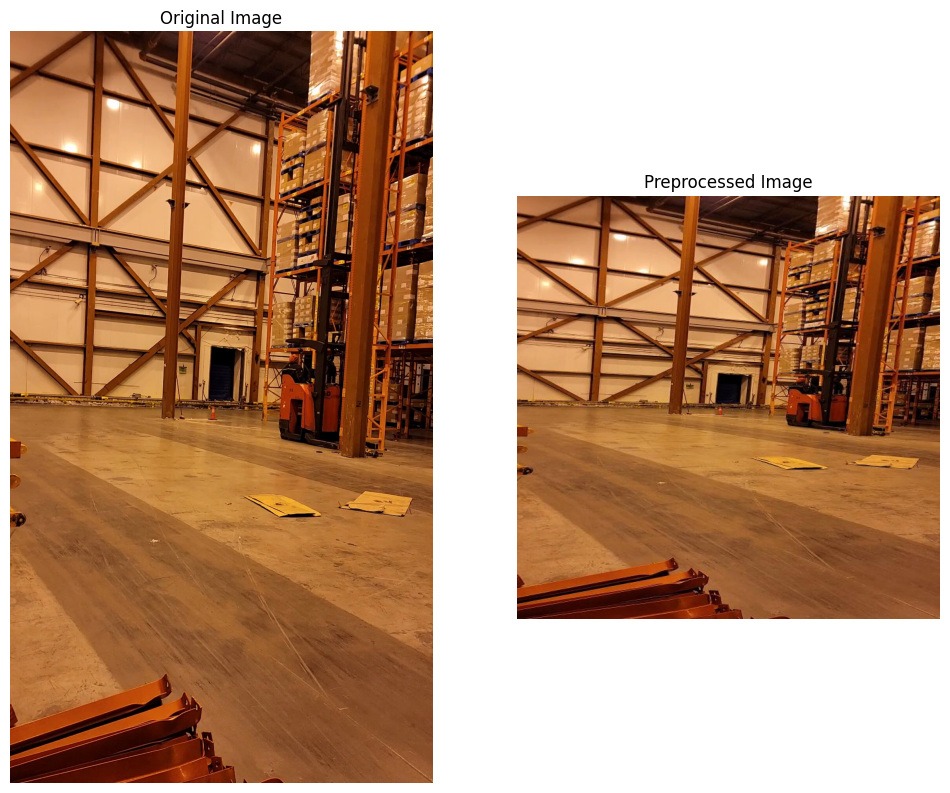

In [ ]:
image_original = '/content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_000.jpg'
image_preprocessed_1 = '/content/matrix-assessment/dataset_labelled/train/images/pexels-rolan-muradov-15170997-1080p-_000_jpg.rf.a682edeb3eb2d6d1e384440f8e5c7c4b.jpg'
images = [
    cv2.imread(image_original),
    cv2.imread(image_preprocessed_1)
]
titles = [
    "Original Image",
    "Preprocessed Image"
]
sv.plot_images_grid(images=images, titles=titles, grid_size=(1,2))

## Data augmentation

The dataset is relatively small and to account for this a number of data augmentations took place. Most notably:
- Flipping both horizontally and vertically.
- Cropping with and without zoom.
- Blurring the input images.

![dataset augmentation](https://i.imgur.com/UvRFFXM.png)

These augmentations were done automatically by the Roboflow platform but could just as well have been [performed in Pytorch](https://pytorch.org/vision/stable/transforms.html) but as a basis these were deemed enough.

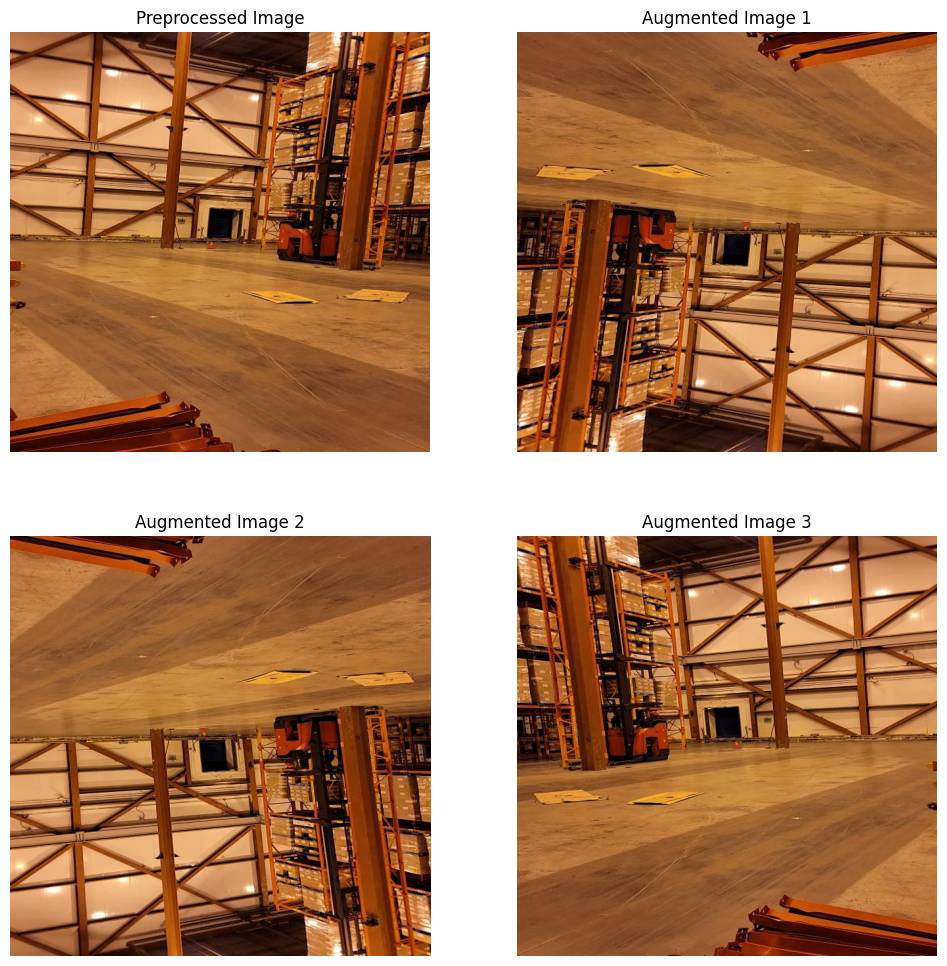

In [ ]:
image_preprocessed_1 = '/content/matrix-assessment/dataset_labelled/train/images/pexels-rolan-muradov-15170997-1080p-_000_jpg.rf.a682edeb3eb2d6d1e384440f8e5c7c4b.jpg'
image_aug_1 = '/content/matrix-assessment/dataset_labelled/train/images/pexels-rolan-muradov-15170997-1080p-_000_jpg.rf.44ec15a3ccbf7768beca8287a884a97a.jpg'
image_aug_2 = '/content/matrix-assessment/dataset_labelled/train/images/pexels-rolan-muradov-15170997-1080p-_000_jpg.rf.d4146c8f1543607ae990b4517c82da00.jpg'
image_aug_3 = '/content/matrix-assessment/dataset_labelled/train/images/pexels-rolan-muradov-15170997-1080p-_000_jpg.rf.dd36f51c7e2c59bdd16383ceb1a62958.jpg'
images = [
    cv2.imread(image_preprocessed_1),
    cv2.imread(image_aug_1),
    cv2.imread(image_aug_2),
    cv2.imread(image_aug_3),
]
titles = [
    "Preprocessed Image",
    "Augmented Image 1",
    "Augmented Image 2",
    "Augmented Image 3"
]
sv.plot_images_grid(images=images, titles=titles, grid_size=(2,2))



## YOLOv8 initial results

The following are the initial results of the YOLOv8 detector without any fine tuning on the data.

In [ ]:
!yolo task=detect mode=predict model=yolov8s.pt conf=0.25 source='/content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_059.jpg' save=True

Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8s summary (fused): 168 layers, 11,156,544 parameters, 0 gradients, 28.6 GFLOPs

image 1/1 /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_059.jpg: 640x384 3 persons, 397.4ms
Speed: 4.0ms preprocess, 397.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


<Figure size 1200x1200 with 0 Axes>

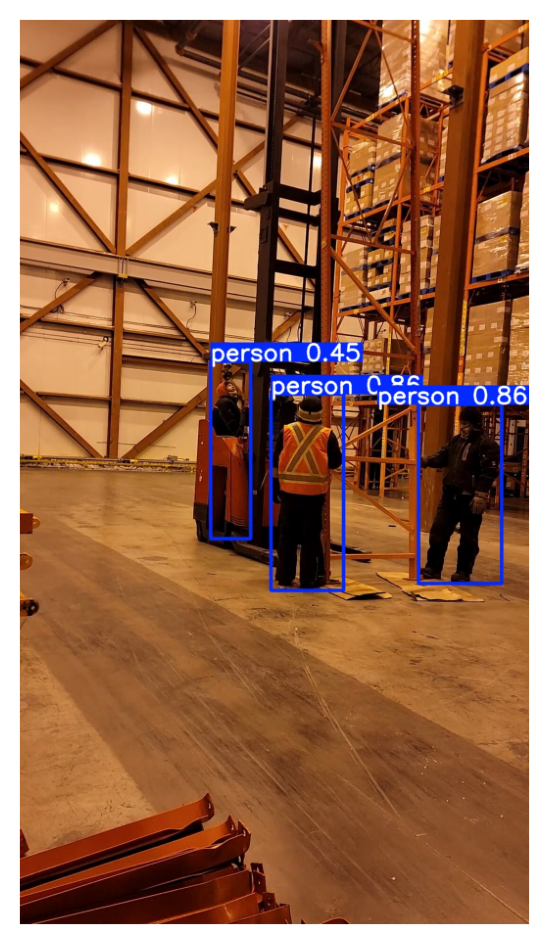

In [ ]:
# Add some logic incase the above is not run
try:
  detection_result_no_finetuning = "/content/runs/detect/predict/pexels-rolan-muradov-15170997 (1080p)_059.jpg"
  image = cv2.imread(detection_result_no_finetuning)
  sv.plot_image(image=image)
except Exception:
  detection_result_no_finetuning = "/content/matrix-assessment/other/pexels-rolan-muradov-15170997 (1080p)_059.png"
  image = cv2.imread(detection_result_no_finetuning)
  sv.plot_image(image=image)


As you can see YOLOv8 already does very well in detecting humans - this is a very common task in Computer Vision and thus being pre-trained in this manner is useful. However, it clearly has no concept of either the forklift or other objects of interest and has a lower confidence for occluded humans (such as the one in the forklift). The training would thus fine-tune the YOLOv8 detector to detect these additional classes of information.

## YOLOv8 Training

Training of the YOLOv8 detector is relatively simple once you have your data in the right format, in this case YOLOv5 + Pytorch with a `data.yaml` file.

### YOLOv8s vs YOLOv8n vs YOLOv8m

![YOLOv8 versions](https://i.imgur.com/DG0HRZ2.png)

When selecting between different versions of YOLOv8, such as YOLOv8n (nano),YOLOv8s (small), and YOLOv8m (medium) there are several considerations to keep in mind:

**Model Size and Overfitting**: YOLOv8m has a larger capacity compared to YOLOv8s, which means it can potentially learn more complex patterns. However, this also makes it more prone to overfitting, especially if the dataset is not sufficiently large or diverse. In contrast, YOLOv8s, being smaller, is less likely to overfit and is generally more robust to noise in smaller datasets.

**Hyperparameter Tuning**: Using the same hyperparameters across different model sizes may not yield optimal results. YOLOv8m might require different learning rates, batch sizes, or training epochs compared to YOLOv8s to achieve the best performance. Larger models like YOLOv8m often need more epochs to converge and may be more susceptible to getting stuck in local minima during training.

**Training Dynamics**: The learning dynamics can differ between model sizes. YOLOv8m, with its increased complexity, might take longer to train effectively and may require adjustments in training strategies compared to the smaller YOLOv8s. YOLOv8s, being simpler, typically converges faster and may require fewer adjustments to training parameters.

In summary, as the dataset is limited in size and diversity, YOLOv8s might be a more suitable choice due to its lower risk of overfitting and more manageable training dynamics. YOLOv8m, while more capable of learning complex patterns, might need more careful tuning and a larger dataset to fully leverage its capacity. The YOLOv8n version is an alternative to YOLOv8s if it is observed that YOLOv8s is overfitting the current data. The others were deemed too large for the relative size of the dataset and improvement in performance.


### The following will take a very long time on CPU
Recommended to not run.

In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data="/content/matrix-assessment/dataset_labelled/data.yaml" epochs=25 imgsz=640 plots=True

### Training issue
When trying to run the above training on Collab the free account would eventually time out. Seeing as this excercise is unlikely to be repeated the following is the output for training the model on my local GPU (2070 Max-Q 8GB).

```
Ultralytics YOLOv8.2.81 🚀 Python-3.12.0 torch-2.4.0+cu121 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/home/student/git/personal/matrix/data/Human Forklift Objects Full.v1i.yolov5pytorch/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=None, workspace=4, nms=False, lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=7.5, cls=0.5, dfl=1.5, pose=12.0, kobj=1.0, label_smoothing=0.0, nbs=64, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.5, shear=0.0, perspective=0.0, flipud=0.0, fliplr=0.5, bgr=0.0, mosaic=1.0, mixup=0.0, copy_paste=0.0, auto_augment=randaugment, erasing=0.4, crop_fraction=1.0, cfg=None, tracker=botsort.yaml, save_dir=runs/detect/train
Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]
  8                  -1  1   1838080  ultralytics.nn.modules.block.C2f             [512, 512, 1, True]
  9                  -1  1    656896  ultralytics.nn.modules.block.SPPF            [512, 512, 5]
 10                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']
 11             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]
 12                  -1  1    591360  ultralytics.nn.modules.block.C2f             [768, 256, 1]
 13                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']
 14             [-1, 4]  1         0  ultralytics.nn.modules.conv.Concat           [1]
 15                  -1  1    148224  ultralytics.nn.modules.block.C2f             [384, 128, 1]
 16                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]
 18                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]
 19                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]
 20             [-1, 9]  1         0  ultralytics.nn.modules.conv.Concat           [1]
 21                  -1  1   1969152  ultralytics.nn.modules.block.C2f             [768, 512, 1]
 22        [15, 18, 21]  1   2117209  ultralytics.nn.modules.head.Detect           [3, [128, 256, 512]]
Model summary: 225 layers, 11,136,761 parameters, 11,136,745 gradients, 28.7 GFLOPs

Transferred 349/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
Downloading https://github.com/ultralytics/assets/releases/download/v8.2.0/yolov8n.pt to 'yolov8n.pt'...
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6.25M/6.25M [00:00<00:00, 37.2MB/s]
AMP: checks passed ✅
/home/student/apps/anaconda3/envs/py312matrix/lib/python3.12/site-packages/ultralytics/engine/trainer.py:271: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(enabled=self.amp)
train: Scanning /home/student/git/personal/matrix/data/Human Forklift Objects Full.v1i.yolov5pytorch/train/labels.cache... 685 images, 0 backgrounds, 0 corrupt: 100%|██████████| 685/6
val: Scanning /home/student/git/personal/matrix/data/Human Forklift Objects Full.v1i.yolov5pytorch/valid/labels.cache... 45 images, 0 backgrounds, 0 corrupt: 100%|██████████| 45/45 [0
Plotting labels to runs/detect/train/labels.jpg...
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically...
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       1/25       3.7G      1.535      1.789      1.388        134        640: 100%|██████████| 43/43 [00:11<00:00,  3.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.94it/s]
                   all         45        328      0.883      0.784      0.865      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       2/25      3.88G      1.253      0.949      1.214        152        640: 100%|██████████| 43/43 [00:10<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  5.86it/s]
                   all         45        328      0.861      0.729      0.841      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       3/25      4.03G      1.207     0.8671      1.202        100        640: 100%|██████████| 43/43 [00:10<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  5.19it/s]
                   all         45        328       0.91      0.791      0.874      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       4/25      4.02G      1.149     0.8034      1.171        161        640: 100%|██████████| 43/43 [00:11<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.52it/s]
                   all         45        328      0.866      0.842      0.883      0.554

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       5/25      4.02G      1.131     0.7664      1.171        143        640: 100%|██████████| 43/43 [00:12<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.22it/s]
                   all         45        328      0.939      0.856      0.931      0.657

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       6/25      4.03G      1.077     0.7101      1.136        140        640: 100%|██████████| 43/43 [00:14<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]
                   all         45        328      0.935      0.938      0.947      0.676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       7/25         4G      1.048     0.6656      1.116        143        640: 100%|██████████| 43/43 [00:20<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.27it/s]
                   all         45        328      0.957      0.936       0.96       0.69

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       8/25      4.04G     0.9982     0.6423      1.101        138        640: 100%|██████████| 43/43 [00:37<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]
                   all         45        328      0.941      0.923      0.962      0.693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       9/25      4.03G     0.9896     0.6211      1.091        149        640: 100%|██████████| 43/43 [00:54<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]
                   all         45        328      0.958      0.929      0.962      0.691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      10/25      4.05G     0.9771      0.602      1.084        189        640: 100%|██████████| 43/43 [00:55<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]
                   all         45        328      0.977       0.93      0.968      0.709

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      11/25      4.02G     0.9443     0.5726      1.066        188        640: 100%|██████████| 43/43 [00:54<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]
                   all         45        328      0.971      0.959       0.98      0.719

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      12/25      3.84G     0.9155     0.5537      1.055        168        640: 100%|██████████| 43/43 [00:54<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]
                   all         45        328      0.958       0.95      0.971      0.725

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      13/25      4.01G     0.8898      0.539      1.048        131        640: 100%|██████████| 43/43 [00:55<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]
                   all         45        328      0.952      0.949      0.971      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      14/25      3.87G     0.8862     0.5281      1.041        164        640: 100%|██████████| 43/43 [01:10<00:00,  1.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.12s/it]
                   all         45        328      0.975      0.961      0.979      0.743

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      15/25      3.97G      0.865     0.5112      1.037        116        640: 100%|██████████| 43/43 [01:36<00:00,  2.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.36s/it]
                   all         45        328      0.964      0.951      0.972      0.728
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      16/25      4.04G     0.7999     0.4584      1.008         97        640: 100%|██████████| 43/43 [01:48<00:00,  2.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.45s/it]
                   all         45        328      0.959      0.948       0.97      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      17/25      4.06G      0.782     0.4388     0.9964         87        640: 100%|██████████| 43/43 [01:48<00:00,  2.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.55s/it]
                   all         45        328      0.966      0.957       0.97      0.728

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      18/25       3.9G     0.7644     0.4268     0.9853         95        640: 100%|██████████| 43/43 [01:48<00:00,  2.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.53s/it]
                   all         45        328      0.987      0.931      0.971      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      19/25      4.02G     0.7479     0.4084     0.9737         91        640: 100%|██████████| 43/43 [01:49<00:00,  2.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.61s/it]
                   all         45        328      0.977      0.929      0.973      0.756

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      20/25      4.04G     0.7156     0.3959     0.9659         92        640: 100%|██████████| 43/43 [01:49<00:00,  2.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.75s/it]
                   all         45        328       0.97      0.947      0.975      0.752

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      21/25      3.88G     0.7024     0.3883     0.9553         91        640: 100%|██████████| 43/43 [01:19<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]
                   all         45        328      0.961      0.952      0.975      0.755

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      22/25      4.05G     0.6927     0.3767     0.9445         94        640: 100%|██████████| 43/43 [01:19<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.01s/it]
                   all         45        328      0.978      0.934      0.975      0.757

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      23/25      4.01G     0.6647     0.3633     0.9354         95        640: 100%|██████████| 43/43 [01:20<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]
                   all         45        328      0.984      0.939      0.971      0.762

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      24/25      4.04G     0.6496     0.3568     0.9349         95        640: 100%|██████████| 43/43 [01:30<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]
                   all         45        328       0.98      0.941      0.971      0.769

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      25/25      4.03G     0.6346     0.3454     0.9286        101        640: 100%|██████████| 43/43 [01:33<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.27s/it]
                   all         45        328      0.977      0.951      0.972      0.771

25 epochs completed in 0.447 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.81 🚀 Python-3.12.0 torch-2.4.0+cu121 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.01it/s]
                   all         45        328      0.977      0.951      0.972       0.77
              forklift         45         45          1       0.99      0.995      0.921
                 human         45        123      0.965      0.886      0.934       0.63
      objectofinterest         45        160      0.966      0.975      0.986      0.759
Speed: 0.4ms preprocess, 31.7ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train
💡 Learn more at https://docs.ultralytics.com/modes/train
```

# Results

Given the above training here are some details about the model:

- Model summary (fused): 168 layers, 11,126,745 parameters
- The model takes rougly:
  - 1.5ms preprocess
  - 95.6ms inference
  - 0.9ms postprocess per image at shape (1, 3, 640, 640)
- Given a specific real-time requirement this may not be fast enough but as shown later it does do well in being able to run on the original image sizes.

Below is an overview of the results and how they are presented as well as some key definitions in terms of evaluation of the model against standard metrics for detections.

## Results overview and definitions

To evaluate the performance of an object detection model, several key metrics are used:

1. **Confusion Matrix:**
   - **Definition:** A confusion matrix presents a summary of classification performance by showing counts of true positives, true negatives, false positives, and false negatives for each class.
   - **Importance:** For object detection, a confusion matrix helps to analyze how well the model distinguishes between different object classes. It reveals where the model is making mistakes, such as confusing one class with another, and provides a detailed breakdown of performance.

2. **Precision:**
   - **Definition:** Precision measures the proportion of true positive detections among all detections made by the model. Essentially, it tells us how many of the model's predicted objects are actually correct.
   - **Formula:** $\text{Precision} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Positives}}$
   - **Importance:** High precision indicates that the model makes fewer false positive detections, which is critical when false detections can lead to undesirable outcomes. Particularly, this is important if we are trying to track specific objects within the dataset and especially if we want to use this to prevent hazardous situations.

3. **Recall:**
   - **Definition:** Recall measures the proportion of true positive detections out of all actual objects present in the dataset. It shows how many of the true objects were detected by the model.
   - **Formula:** $\text{Recall} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Negatives}}$
   - **Importance:** High recall means that the model detects most of the actual objects, which is important in scenarios where missing objects could be problematic.

4. **mAP@50 (Mean Average Precision at IoU 0.50):**
   - **Definition:** mAP@50 is the mean Average Precision calculated at an Intersection over Union (IoU) threshold of 0.50. Average Precision (AP) evaluates the precision-recall tradeoff for a single class, and mAP averages this across all classes.
   - **Importance:** This metric provides a summary of how well the model performs when the overlap between predicted and ground-truth bounding boxes is at least 50%. It’s useful for understanding the model’s accuracy at a specific IoU threshold.

5. **mAP@50-95 (Mean Average Precision at IoU thresholds 0.50 to 0.95):**
   - **Definition:** mAP@50-95 calculates the mean Average Precision across multiple IoU thresholds, ranging from 0.50 to 0.95 in increments of 0.05. This offers a more nuanced view of model performance across various levels of detection overlap.
   - **Importance:** This metric gives a detailed evaluation of how well the model performs across different IoU thresholds, providing insights into the model's ability to maintain accuracy at varying levels of precision.

In summary:
- **Confusion Matrix** provides a detailed view of class-level performance.
- **Precision** reflects the accuracy of the model's detections.
- **Recall** indicates how many true objects were detected.
- **mAP@50** measures performance at a specific IoU threshold.
- **mAP@50-95** offers a comprehensive evaluation across various IoU thresholds.

These metrics collectively help in understanding the effectiveness and reliability of the fine-tuned YOLOv8s model, guiding improvements and adjustments in the future.

### Validation Set

#### Prediction (label mode)

In [ ]:
!yolo task=detect mode=predict model="/content/matrix-assessment/best/weights/best.pt" conf=0.25 source="/content/matrix-assessment/dataset_labelled/valid/images/" plots=True

Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs

image 1/45 /content/matrix-assessment/dataset_labelled/valid/images/pexels-rolan-muradov-15170997-1080p-_001_jpg.rf.af900276dc138bd9f41fadff317a6568.jpg: 640x640 1 forklift, 1 human, 4 objectofinterests, 644.9ms
image 2/45 /content/matrix-assessment/dataset_labelled/valid/images/pexels-rolan-muradov-15170997-1080p-_013_jpg.rf.125938d2053fbd2e7df7b868c5b5f051.jpg: 640x640 1 forklift, 4 humans, 3 objectofinterests, 578.0ms
image 3/45 /content/matrix-assessment/dataset_labelled/valid/images/pexels-rolan-muradov-15170997-1080p-_029_jpg.rf.abfb2267724da66f93ef05af7fe0f9ae.jpg: 640x640 1 forklift, 3 humans, 3 objectofinterests, 574.2ms
image 4/45 /content/matrix-assessment/dataset_labelled/valid/images/pexels-rolan-muradov-15170997-1080p-_036_jpg.rf.3f1321c048bf06e6323c3a0a26b94c9d.jpg: 640x640 3 forklifts, 2 humans, 5 objecto

image count: 45


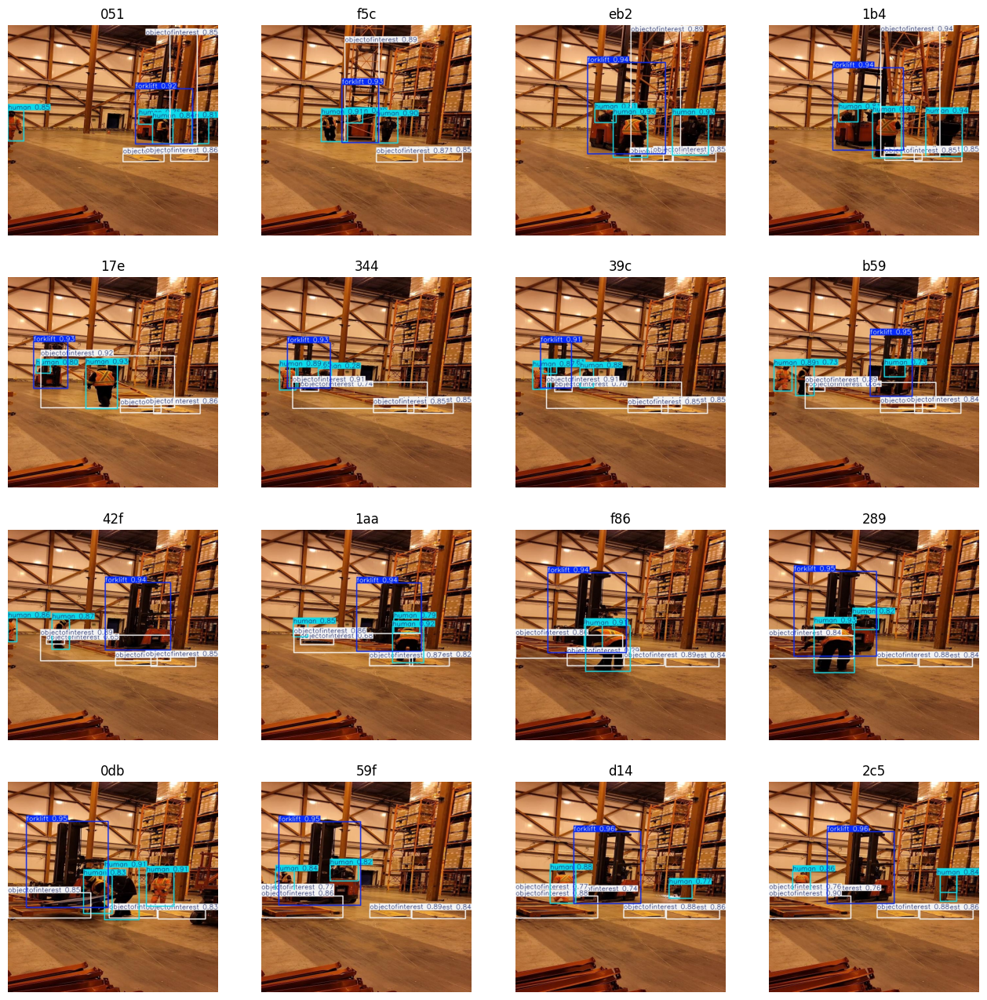

In [ ]:
IMAGE_DIR_PATH = f"/content/matrix-assessment/runs/detect/predict-validation_set"
SAMPLE_SIZE = 16
SAMPLE_GRID_SIZE = (4, 4)
SAMPLE_PLOT_SIZE = (16, 16)

image_paths = sv.list_files_with_extensions(
    directory=IMAGE_DIR_PATH,
    extensions=["jpg"])

print('image count:', len(image_paths))

image_paths = sorted(image_paths)
image_paths_sampled = image_paths[1::3]
image_paths_sampled.append(image_paths[-1])

titles = []
images = []
for image_path in image_paths_sampled:
  titles.append(image_path.stem[-3:])
  images.append(cv2.imread(str(image_path)))

sv.plot_images_grid(images=images, titles=titles, grid_size=SAMPLE_GRID_SIZE, size=SAMPLE_PLOT_SIZE)

#### Prediction (label mode) discussion
An eyeball of the provided images results appears to indicate that the model does quite well in tracking the forklift across the images. It also does well in tracking humans and objects of interest but not as well as the forklift.

#### Validate mode (assessment)


In [ ]:
!yolo task=detect mode=val model="/content/matrix-assessment/best/weights/best.pt" conf=0.25 source="/content/matrix-assessment/dataset_labelled/valid/images/" data="/content/matrix-assessment/dataset_labelled/data.yaml" plots=True

Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs
100% 755k/755k [00:00<00:00, 15.0MB/s]
val: Scanning /content/matrix-assessment/dataset_labelled/valid/labels... 45 images, 0 backgrounds, 0 corrupt: 100% 45/45 [00:00<00:00, 1157.13it/s]
val: New cache created: /content/matrix-assessment/dataset_labelled/valid/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 3/3 [00:41<00:00, 13.72s/it]
                   all         45        328      0.975      0.946       0.97      0.788
              forklift         45         45          1      0.978      0.988      0.916
                 human         45        123      0.965      0.886      0.938      0.665
      objectofinterest         45        160       0.96      0.975      0.984      0.783
Speed: 9.1ms preprocess, 891.9ms inference, 0.0ms loss, 0.5ms postprocess per 

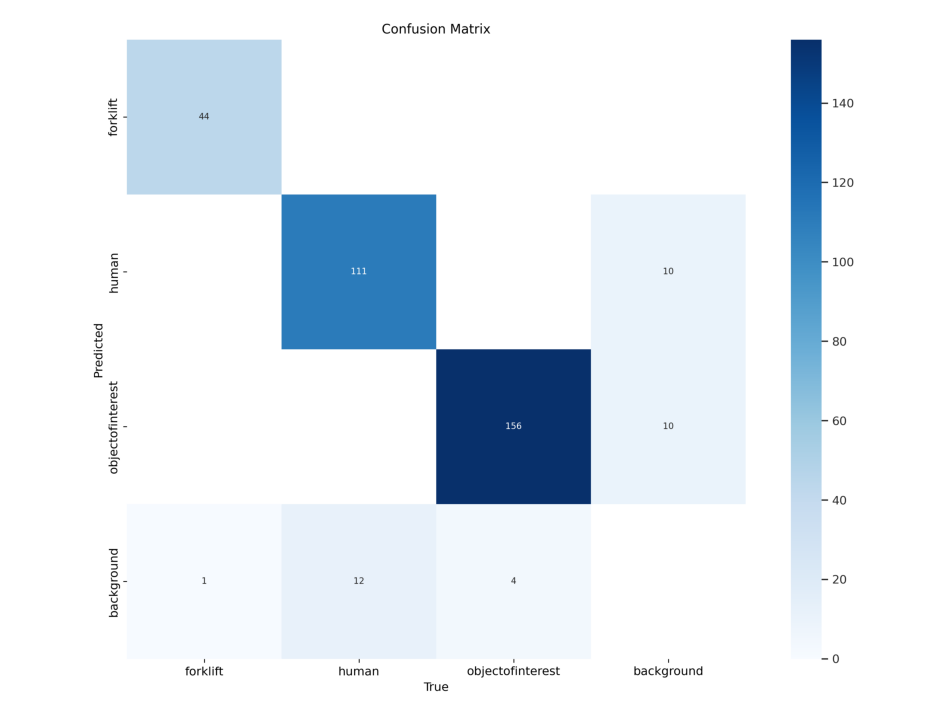

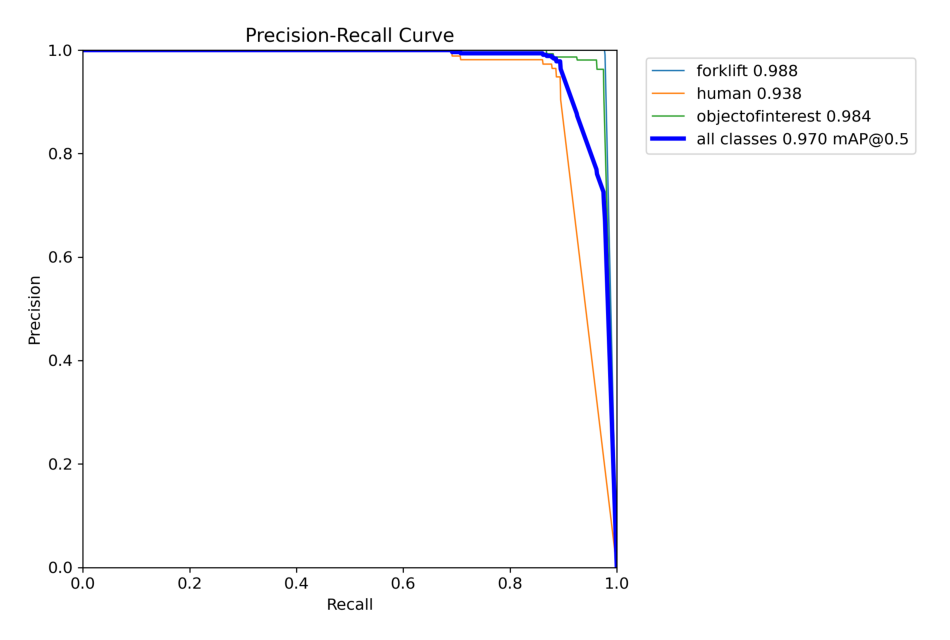

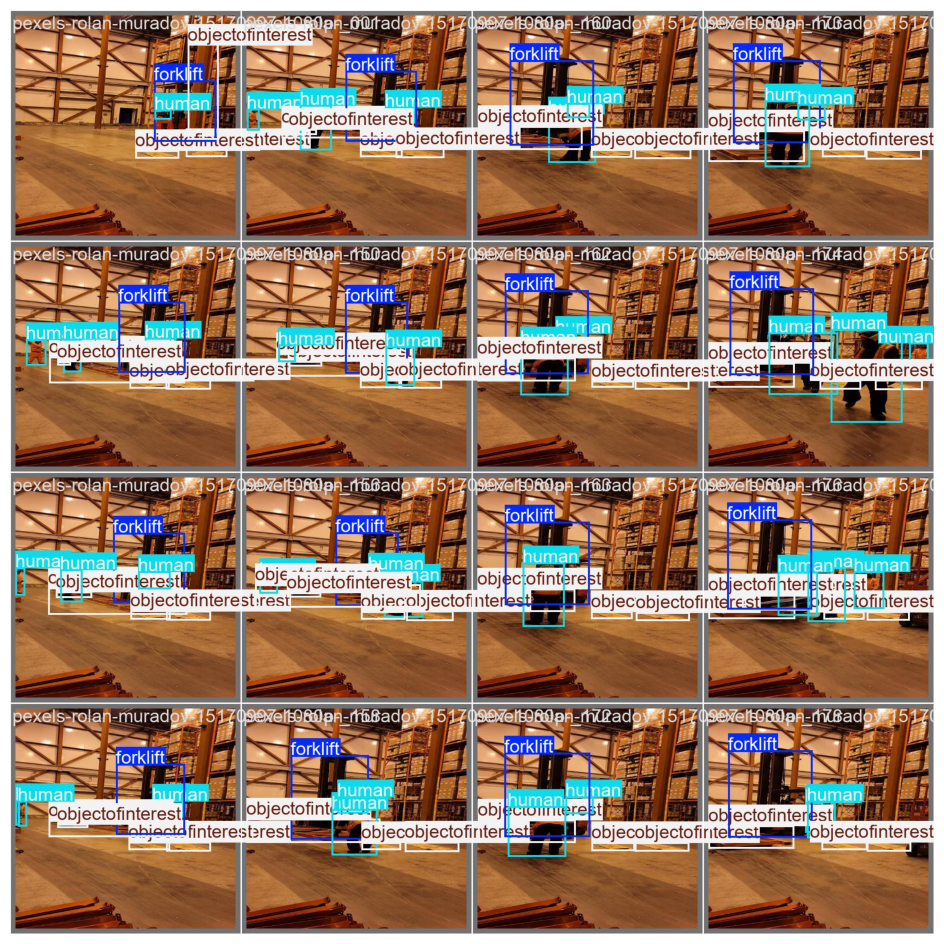

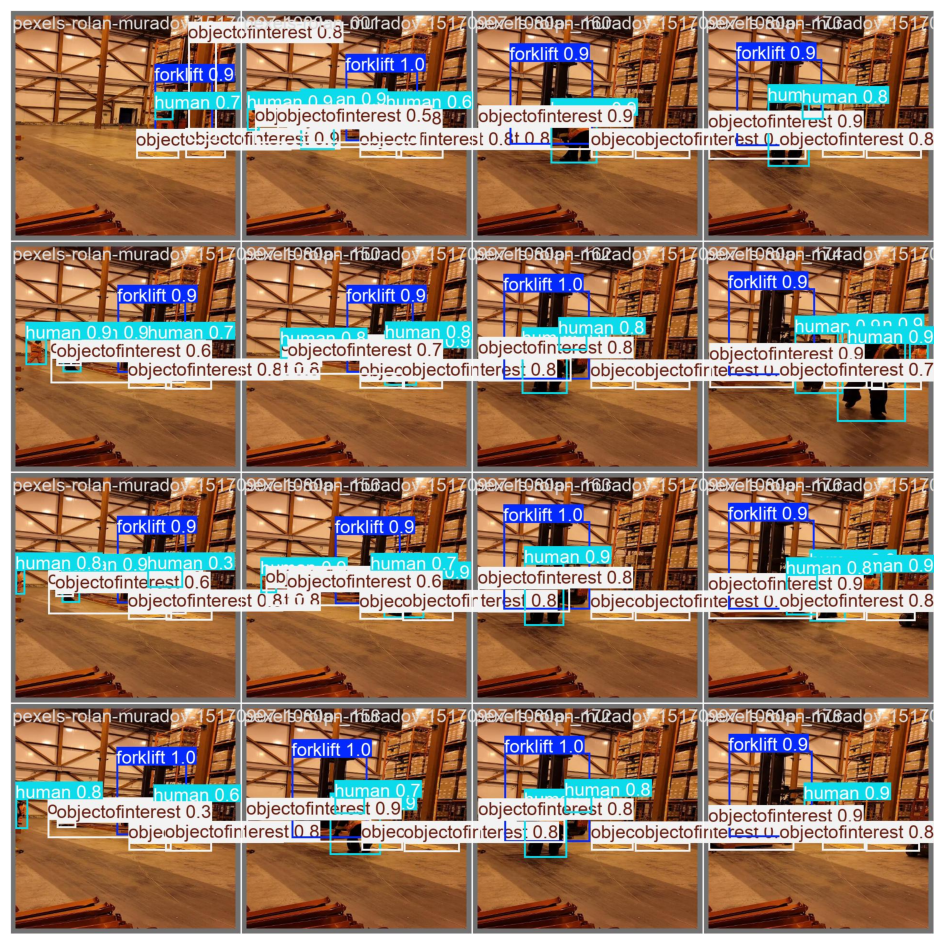

In [ ]:
folder = '/content/matrix-assessment/runs/detect/val-validation_set/'

list_of_images = [
    'confusion_matrix.png',
    'PR_curve.png',
    'val_batch0_labels.jpg',
    'val_batch0_pred.jpg'
]

images = []
for image_str in list_of_images:
  sv.plot_image(image=cv2.imread(f'{folder}/{image_str}'))

#### Overall Model Performance on the Validation Set

1. **General Performance:**
   - **Precision (P):** The model has an overall precision of 0.975, meaning that 97.5% of the detections made by the model are correct. This high precision indicates that the model has a low rate of false positives.
   - **Recall (R):** The model's overall recall is 0.946, showing that it successfully detects 94.6% of the true objects present in the images. This high recall indicates that the model is good at identifying most of the objects.
   - **mAP50 (Mean Average Precision at IoU 0.50):** The mAP50 is 0.97, which is very high. This indicates that, on average, the model has good performance in terms of correctly detecting objects with at least 50% overlap between the predicted and ground-truth bounding boxes.
   - **mAP50-95 (Mean Average Precision at IoU thresholds from 0.50 to 0.95):** The mAP50-95 is 0.788, showing strong performance across a range of IoU thresholds. This suggests that the model maintains good detection accuracy even as the required overlap between predictions and ground truth increases.

2. **Performance by Class:**
   - **Forklift:**
     - **Precision:** 1.0 (100%) - The model perfectly detects forklifts with no false positives.
     - **Recall:** 0.978 - It successfully detects 97.8% of the actual forklifts.
     - **mAP50:** 0.988 - Excellent performance at the 50% IoU threshold.
     - **mAP50-95:** 0.916 - Very good performance across varying IoU thresholds.

   - **Human:**
     - **Precision:** 0.965 - The model correctly identifies 96.5% of the detected humans.
     - **Recall:** 0.886 - It detects 88.6% of the actual humans present.
     - **mAP50:** 0.938 - Strong performance at the 50% IoU threshold.
     - **mAP50-95:** 0.665 - The model's performance is somewhat lower across varying IoU thresholds, indicating that detection quality drops as the required overlap increases.

   - **Object of Interest:**
     - **Precision:** 0.96 - The model has a high precision of 96% for detecting objects of interest.
     - **Recall:** 0.975 - It successfully detects 97.5% of the actual objects of interest.
     - **mAP50:** 0.984 - Very good performance at the 50% IoU threshold.
     - **mAP50-95:** 0.783 - Strong performance across IoU thresholds, though slightly lower than the precision and recall metrics.

**Summary:**

- **Overall Performance:** The model demonstrates excellent precision and recall, with very high mAP50 and strong mAP50-95 scores, indicating that it performs well in detecting objects and maintaining accuracy across different levels of overlap.
- **Class-Specific Performance:** The model excels in detecting forklifts and objects of interest, showing perfect precision for forklifts and high recall. Human detection shows slightly lower recall and mAP50-95, suggesting room for improvement in detecting humans with high overlap.

Overall, the model performs exceptionally well on the validation set, but attention may be needed for improving detection accuracy for specific classes, particularly at higher IoU thresholds.

### Test set

#### Prediction (label mode)

In [ ]:
!yolo task=detect mode=predict model="/content/matrix-assessment/best/weights/best.pt" conf=0.25 source="/content/matrix-assessment/dataset_labelled/test/images/" plots=True

Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs

image 1/46 /content/matrix-assessment/dataset_labelled/test/images/pexels-rolan-muradov-15170997-1080p-_004_jpg.rf.1f853e34c88bf936b5d25008a1ef8f8b.jpg: 640x640 1 forklift, 1 human, 4 objectofinterests, 614.4ms
image 2/46 /content/matrix-assessment/dataset_labelled/test/images/pexels-rolan-muradov-15170997-1080p-_005_jpg.rf.bd99e54e662da2b92dfdade65c5a42f2.jpg: 640x640 1 forklift, 1 human, 4 objectofinterests, 540.1ms
image 3/46 /content/matrix-assessment/dataset_labelled/test/images/pexels-rolan-muradov-15170997-1080p-_006_jpg.rf.530f67fbc2fc1e98790978a9ce584f4e.jpg: 640x640 1 forklift, 2 humans, 4 objectofinterests, 518.2ms
image 4/46 /content/matrix-assessment/dataset_labelled/test/images/pexels-rolan-muradov-15170997-1080p-_008_jpg.rf.91be8040157b616ce16a9cff0e730885.jpg: 640x640 1 forklift, 3 humans, 3 objectofinter

image count: 46


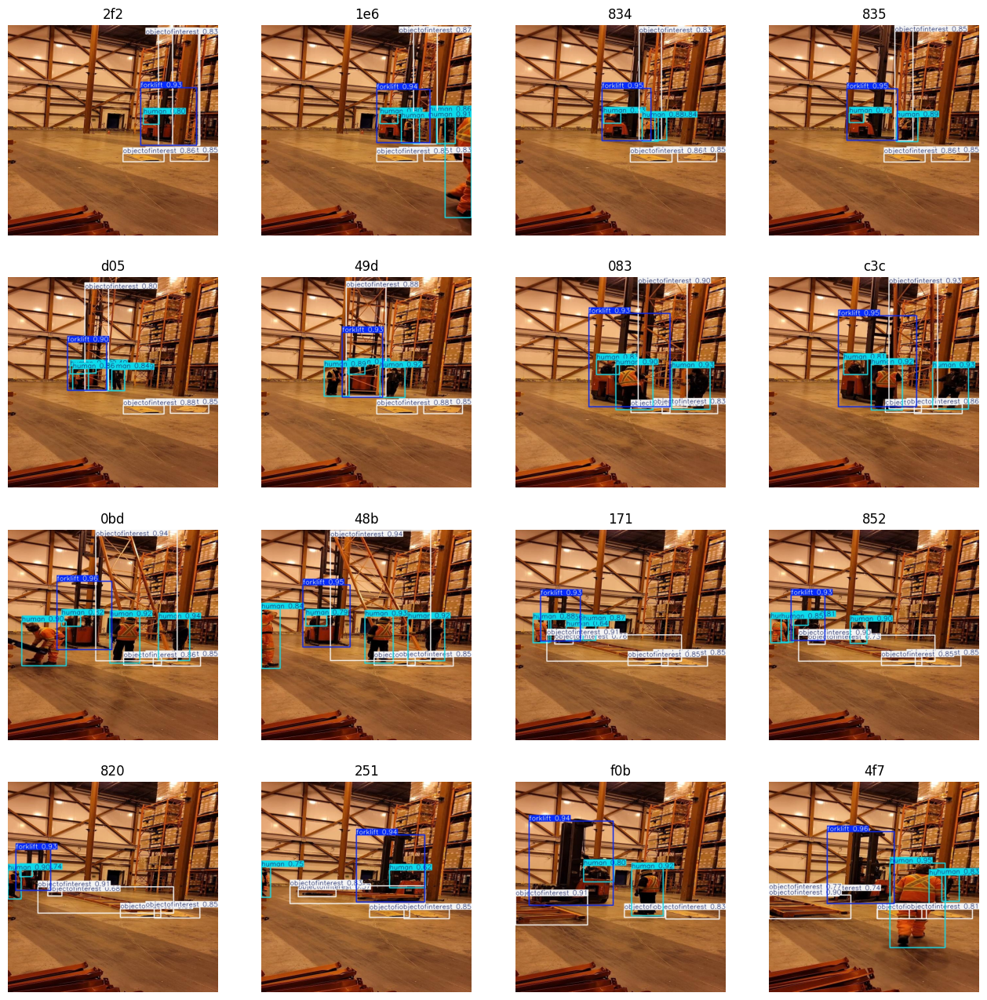

In [ ]:
IMAGE_DIR_PATH = f"/content/matrix-assessment/runs/detect/predict-test_set"
SAMPLE_SIZE = 16
SAMPLE_GRID_SIZE = (4, 4)
SAMPLE_PLOT_SIZE = (16, 16)

image_paths = sv.list_files_with_extensions(
    directory=IMAGE_DIR_PATH,
    extensions=["jpg"])

print('image count:', len(image_paths))

image_paths = sorted(image_paths)
image_paths_sampled = image_paths[1::3]
image_paths_sampled.append(image_paths[-1])

titles = []
images = []
for image_path in image_paths_sampled:
  titles.append(image_path.stem[-3:])
  images.append(cv2.imread(str(image_path)))

sv.plot_images_grid(images=images, titles=titles, grid_size=SAMPLE_GRID_SIZE, size=SAMPLE_PLOT_SIZE)

#### Prediction (label mode) discussion
An eyeball of the provided test shows almost no difference in performance on the test data set compared to the validation dataset. The model does quite well in tracking the forklift across the images. It also does well in tracking humans and objects of interest but not as well as the forklift.


#### Validate mode (assessment)

NOTE: There is an open ticket on YOLOv8's github about allowing validation on your testing data: https://github.com/ultralytics/ultralytics/issues/523. Understandable behaviour by the devs but requires some changes to the `data.yaml` to validate the model using the test set.

In [ ]:
!yolo task=detect mode=val model="/content/matrix-assessment/best/weights/best.pt" conf=0.25 source="/content/matrix-assessment/dataset_labelled/test/images/" data="/content/matrix-assessment/dataset_labelled/data_test_swap.yaml" plots=True

Ultralytics YOLOv8.2.82 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/matrix-assessment/dataset_labelled/test/labels... 46 images, 0 backgrounds, 0 corrupt: 100% 46/46 [00:00<00:00, 2930.58it/s]
val: New cache created: /content/matrix-assessment/dataset_labelled/test/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 3/3 [00:37<00:00, 12.48s/it]
                   all         46        336      0.987      0.977      0.987      0.805
              forklift         46         46          1          1      0.995      0.934
                 human         46        135      0.981      0.963      0.983      0.718
      objectofinterest         46        155      0.981      0.968      0.983      0.763
Speed: 11.5ms preprocess, 787.3ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs/detect/val2


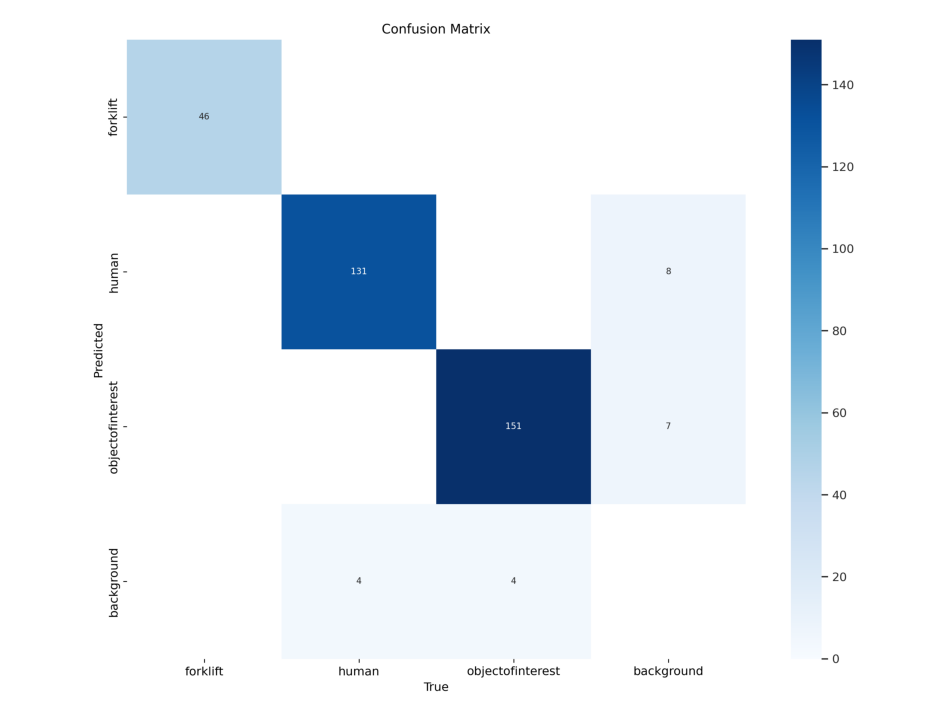

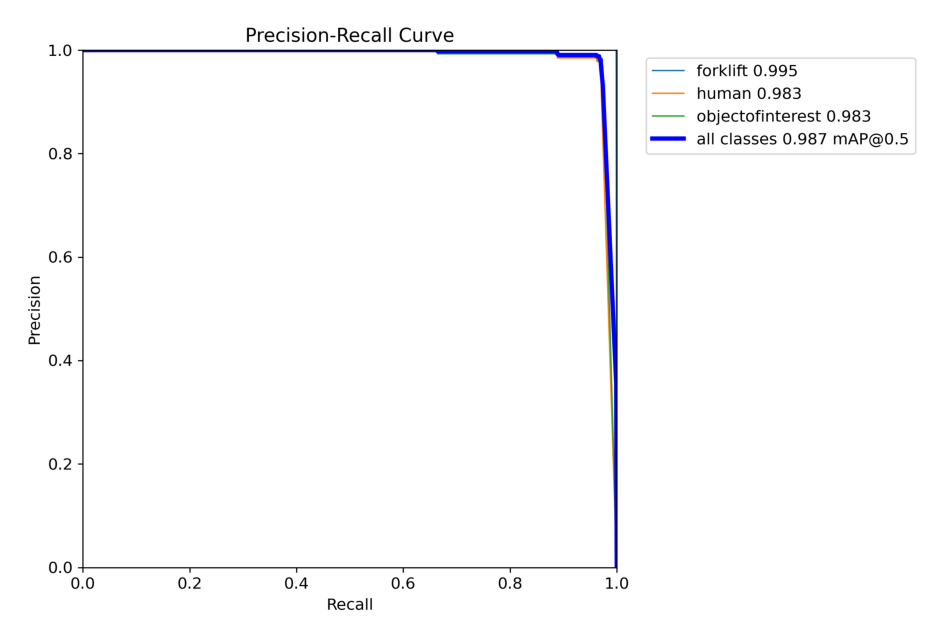

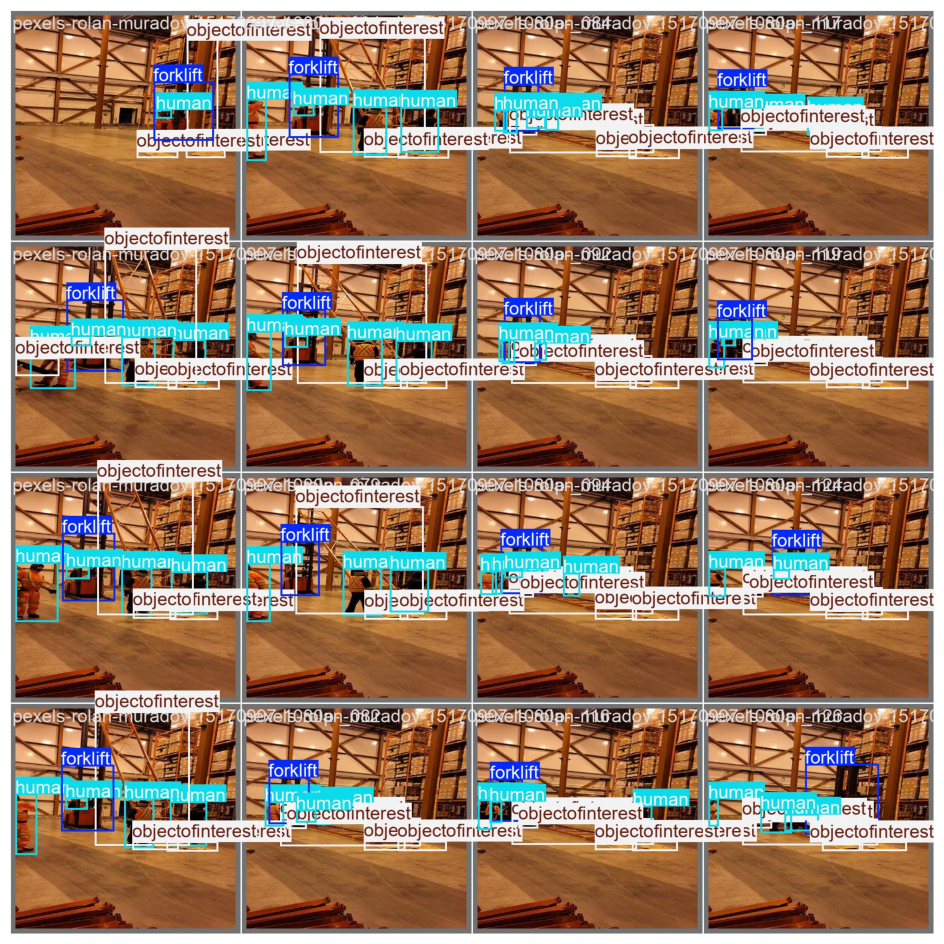

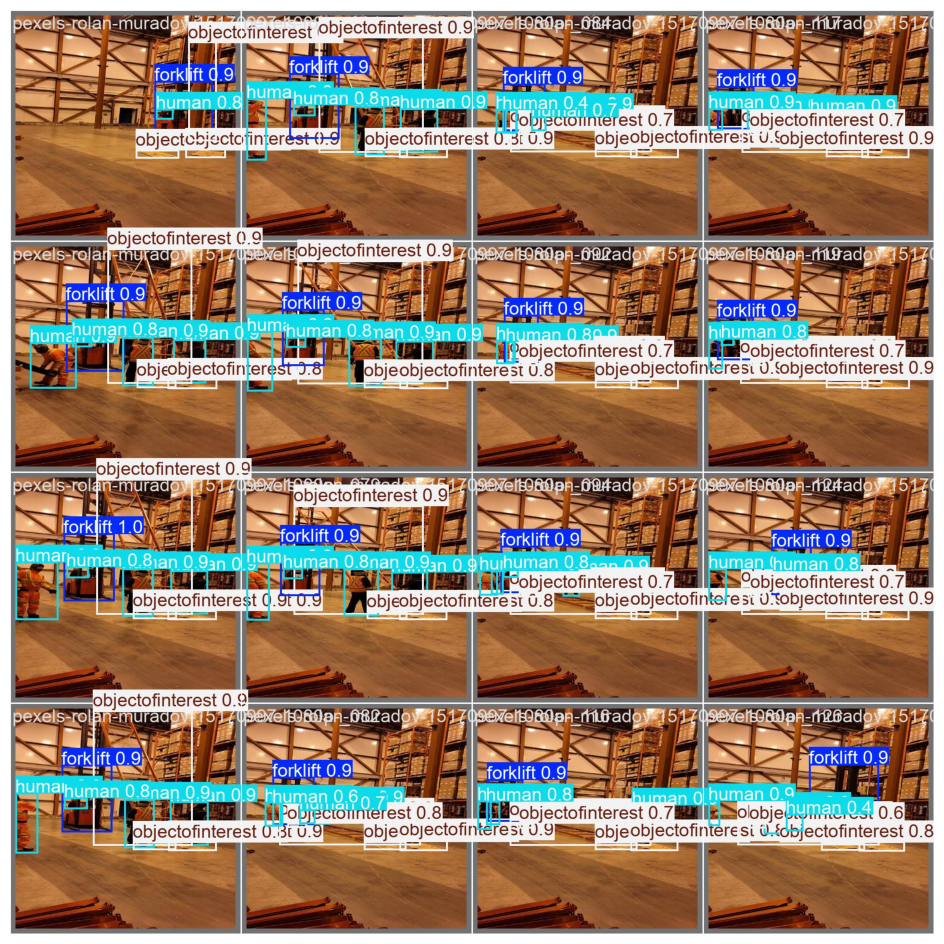

In [ ]:
folder = '/content/matrix-assessment/runs/detect/val-test_set/'

list_of_images = [
    'confusion_matrix.png',
    'PR_curve.png',
    'val_batch0_labels.jpg',
    'val_batch0_pred.jpg'
]

images = []
for image_str in list_of_images:
  sv.plot_image(image=cv2.imread(f'{folder}/{image_str}'))

#### Overall Model Performance on the Test Set:

The model's performance on the test set is strong, with the following key metrics:

- **Overall Performance:**
  - **Precision (P):** 0.987 – The model achieves a precision of 98.7%, indicating that nearly all detected objects are true positives. This reflects a very low rate of false positives, suggesting high reliability in the model's detections.
  - **Recall (R):** 0.977 – The recall score of 97.7% shows that the model detects 97.7% of the actual objects in the test set, indicating its effectiveness in identifying most of the true positives.
  - **mAP50 (Mean Average Precision at IoU 0.50):** 0.987 – The mAP50 of 98.7% demonstrates excellent performance at a 50% IoU threshold. This indicates that the model is highly accurate in detecting objects with at least moderate overlap.
  - **mAP50-95 (Mean Average Precision at IoU thresholds from 0.50 to 0.95):** 0.805 – The mAP50-95 of 80.5% shows strong performance across a range of IoU thresholds. This indicates that the model maintains good detection accuracy even as the overlap requirement becomes more stringent.
  - In all of these overall performance metrics the performance of the model improved with the test set.
    - The better performance on the test set compared to the validation set might be due to a few reasons. The test set could be more representative of the model’s strengths or might have examples that are easier for the model to handle. On the other hand, the validation set might have included more challenging or varied examples, which could explain the lower performance there. Although it’s promising that the test set results are strong, it’s important to ensure that this isn’t just a coincidence. Additional validation with more diverse data and techniques like cross-validation would help confirm the model’s overall reliability and effectiveness.


- **Class-Specific Performance:**
  - **Forklift:**
    - **Precision:** 1.0 – The model perfectly detects forklifts, with no false positives.
    - **Recall:** 1.0 – It achieves perfect recall, successfully identifying all forklifts in the test set.
    - **mAP50:** 0.995 – The model performs exceptionally well at the 50% IoU threshold for forklifts.
    - **mAP50-95:** 0.934 – It maintains very high performance across different IoU thresholds for forklifts.
  - **Human:**
    - **Precision:** 0.981 – The model has high precision for detecting humans.
    - **Recall:** 0.963 – It detects 96.3% of the actual humans in the test set.
    - **mAP50:** 0.983 – Excellent performance at the 50% IoU threshold for human detection.
    - **mAP50-95:** 0.718 – Performance decreases slightly with higher IoU thresholds, indicating potential areas for improvement.
  - **Object of Interest:**
    - **Precision:** 0.981 – High precision for detecting objects of interest.
    - **Recall:** 0.968 – It detects 96.8% of the objects of interest.
    - **mAP50:** 0.983 – Very strong performance at the 50% IoU threshold.
    - **mAP50-95:** 0.763 – Good performance across IoU thresholds, though slightly lower compared to forklifts.

**Model Speed:**

- **Preprocessing Time:** 0.9 ms per image – This indicates that the preprocessing step is efficient and quick.
- **Inference Time:** 107.3 ms per image – This shows that the model takes 107.3 milliseconds to make predictions on each image, which is relatively fast and may be suitable for real-time applications. For cases where say, 30 FPS is necessary, this would be too slow though.
- **Loss Time:** 0.0 ms per image – The loss computation time is negligible, which suggests that the loss function does not significantly impact the overall processing time.
- **Postprocessing Time:** 0.3 ms per image – The postprocessing step is also very quick, contributing minimally to the total processing time. This is because on the test set the input image and the output images are the same size - 640 x 640.

**Conclusion:**

The model demonstrates outstanding performance on the test set, with high precision, recall, and robust mAP scores across different IoU thresholds. However, there is a slight drop in performance for certain classes at higher IoU thresholds, indicating potential areas for improvement in detection accuracy, especially in more challenging scenarios.

While these metrics are encouraging, it is important to interpret them with some caution. The relatively small size of the test and validation sets might limit how well these results generalize to different or larger datasets. Furthermore, the lack of cross-validation means the performance evaluation is based on a single data split, which might not fully reflect the model’s robustness and stability. To gain a more comprehensive understanding of the model's true performance, further validation with larger and more varied datasets, along with cross-validation, would be beneficial.

### Full set
Assessing the model against the original dataset with full-size image dimensions is crucial for ensuring that the fine-tuned YOLOv8 model's performance generalizes well to real-world conditions. The preprocessing step, which involved resizing the images to 640 x 640, may have introduced changes that affect the model's ability to handle images at their original resolution. Evaluating the model on the original dataset helps verify that it performs effectively on images that match the dimensions it will encounter in practical applications (1080 x 1920), ensuring that the model’s predictions remain accurate and reliable in the context for which it was originally designed.

NOTE: Due to the number of images not all of the original images are shown below. It can be seen within the `matrix-assessment/runs/detect/predict-full_set` in this notebook or [within the repo](https://github.com/Xirious/matrix-assessment)

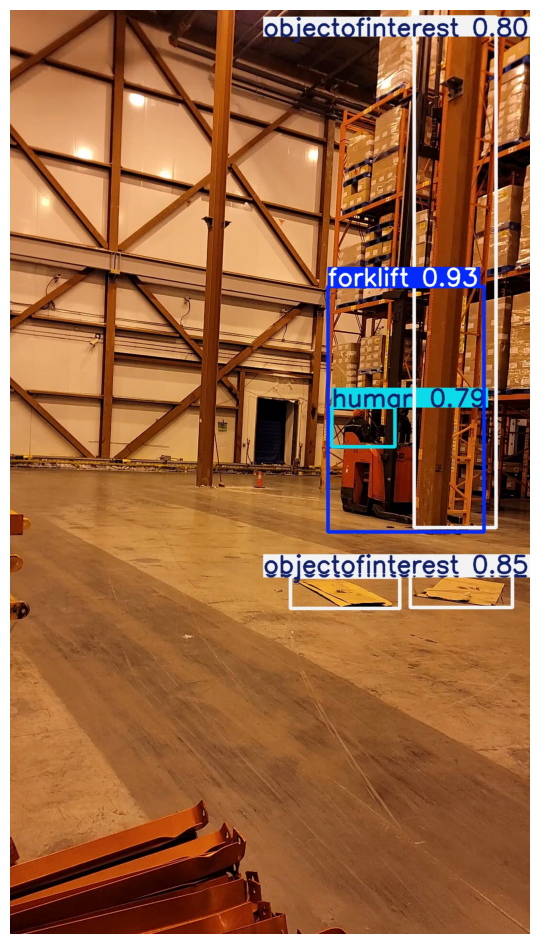

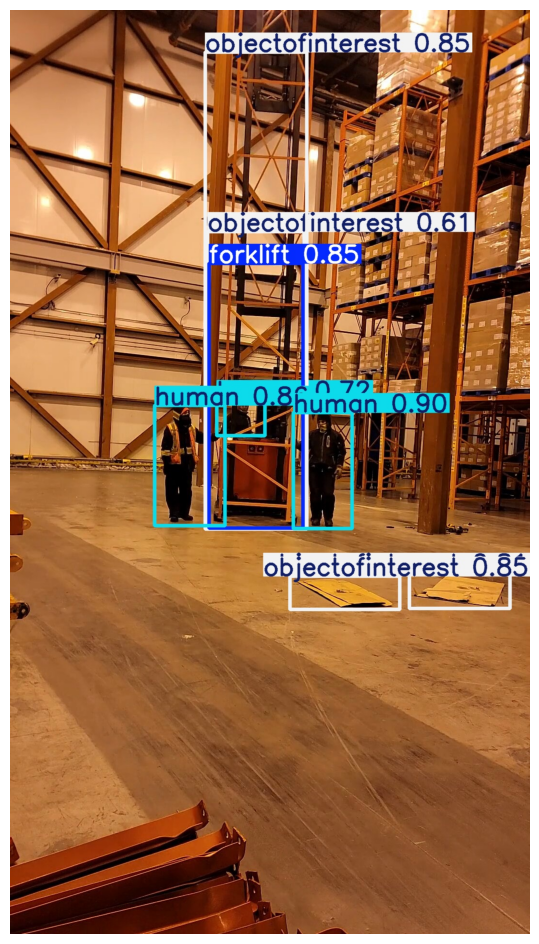

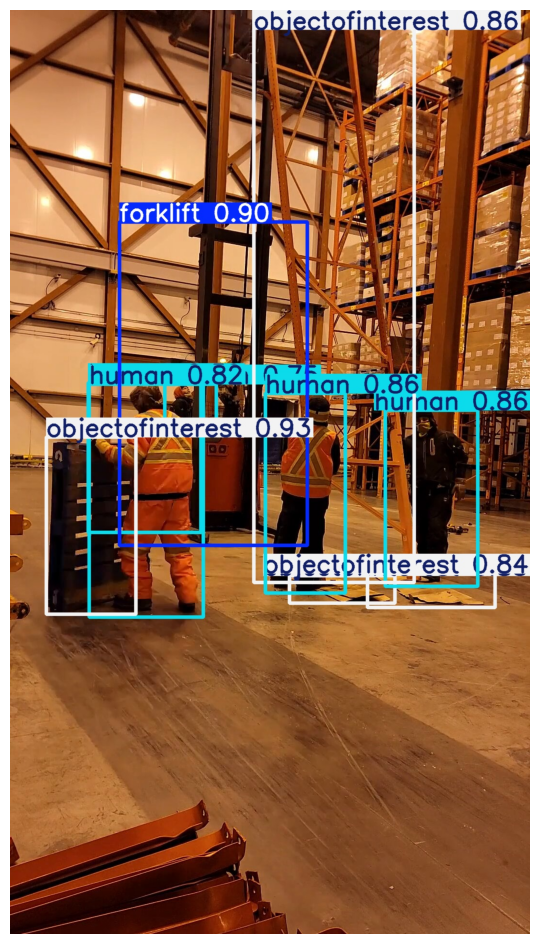

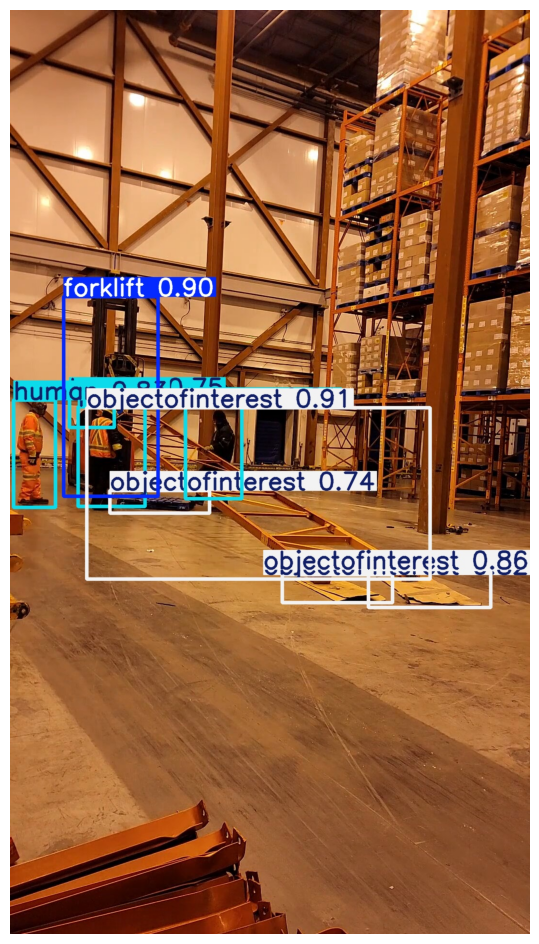

In [ ]:
folder = f"/content/matrix-assessment/runs/detect/predict-full_set"

list_of_images = [
    'pexels-rolan-muradov-15170997 (1080p)_000.jpg',
    'pexels-rolan-muradov-15170997 (1080p)_042.jpg',
    'pexels-rolan-muradov-15170997 (1080p)_070.jpg',
    'pexels-rolan-muradov-15170997 (1080p)_107.jpg'
]

images = []
for image_str in list_of_images:
  sv.plot_image(image=cv2.imread(f'{folder}/{image_str}'))

## Discussion of results on full dataset

The model appears to perform well using the original input images. Some interesting things to note:
- Positives
  - The confidence level of the model has improved for humans but is especially good for the forklift. This is expected given the performance shown in the validation and test sets but it is good to see that the model generalises well for these longer original images.
  - Humans are not only detected as long-only objects but also more "square" shapes when they are sitting inside the forklift or bending down.
  - The truss is correctly tracked whether it is standing up straight or is being layed flat.
  - The two pieces of cardboard on the ground is well tracked throughout the images.
- Negatives:
  - The blue wooden crate is located for a good portion of the images but in some cases it is not tracked. This is likely due to it being the object with the least number of examples within the dataset so augmentations in future versions including more variations of this object would help alleviate the cases where the crate is not tracked properly.
  - Sometimes, around 10 times, the detector would detect multiples of the forklift. Obviously this is an issue but the model was not penalised for detecting more than one example. This issue is somewhat sidestepped in the code below by only (manually) selecting the forklifts with the highest confidence returned from the model. A more detailed penalisation and filtering structure would help address this problem in the long term.


## Cross-validation

Although cross-validation is important for assessing model performance, especially for smaller datasets, time constraints prevented its implementation. Given the limited timeframe, the focus was on immediate tasks such as model training and initial evaluations across the validation, test and full set of data. As a result, cross-validation could not be performed, which would have provided a more robust assessment of model performance.

# Forklift Movement Metrics

### Preprocess the full dataset

The following code preprocesses the entire dataset at full resolution so we can accurately track the forklift and other objects without distortion.

The data is put into three dictionaries:
- `forklift_dict` which contains the bounding boxes, confidences and indexes of where the forklift was detected.
- `human_dict` which contains the bounding boxes, confidences and indexes of where all the humans in the frame were detected.
- `objectofinterest_dict` which contains the bounding boxes, confidences and indexes of where the objects of interest were detected.

In [ ]:
from ultralytics import YOLO
from collections import defaultdict

IMAGE_FULL_DATASET_DIR_PATH = '/content/matrix-assessment/dataset_full'
BEST_MODEL = '/content/matrix-assessment/best/weights/best.pt'

image_paths = sv.list_files_with_extensions(
    directory=IMAGE_FULL_DATASET_DIR_PATH,
    extensions=["jpg"])

image_paths = sorted(image_paths)

model = YOLO(BEST_MODEL)

forklift_dict = defaultdict(list)
human_dict = defaultdict(list)
objectofinterest_dict = defaultdict(list)

counter = 0

# These are the list of indexes with double forklift detections that should be ignored.
# NOTE: at some point this would be detected automatically using the confidences
# but for this work it was important to get results quicker than have a fully
# realised system in the available time.
ignore_list = [17,19,21,38,71,74,106,108,110,151]

for index, image_path in enumerate(image_paths):

  # Sometimes the detector detects two separate forklifts
  # in one image.
  print(f"Processing path: {image_path}")

  # Use best model to predict current image boxes
  results = model.predict(source=str(image_path), conf=0.25)

  # Extract bounding boxes, classes, names, and confidences
  boxes = results[0].boxes.xyxy.tolist()
  classes = results[0].boxes.cls.tolist()
  names = results[0].names
  confidences = results[0].boxes.conf.tolist()

  for box, cls, conf in zip(boxes, classes, confidences):
      x1, y1, x2, y2 = box
      confidence = conf
      detected_class = cls
      name = names[int(cls)]

      # We need to ensure only 1 forklift is captured per scene.
      if "fork" in name:
        if counter in ignore_list:
          print(f"Skipping fork {counter}")
          counter = counter + 1
          continue
        forklift_dict['bounding_boxes'].append(box)
        forklift_dict['confidences'].append(confidence)
        forklift_dict['indexes'].append(index)
        counter = counter + 1

      # Also capture human and objects bounding boxes
      if "human" in name:
        human_dict['bounding_boxes'].append(box)
        human_dict['confidences'].append(confidence)
        human_dict['indexes'].append(index)

      if "objectofinterest" in name:
        objectofinterest_dict['bounding_boxes'].append(box)
        objectofinterest_dict['confidences'].append(confidence)
        objectofinterest_dict['indexes'].append(index)



Processing path: /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_000.jpg

image 1/1 /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_000.jpg: 640x384 1 forklift, 1 human, 3 objectofinterests, 324.5ms
Speed: 2.8ms preprocess, 324.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Processing path: /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_001.jpg

image 1/1 /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_001.jpg: 640x384 1 forklift, 1 human, 3 objectofinterests, 311.7ms
Speed: 3.9ms preprocess, 311.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Processing path: /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_002.jpg

image 1/1 /content/matrix-assessment/dataset_full/pexels-rolan-muradov-15170997 (1080p)_002.jpg: 640x384 1 forklift, 1 human, 4 objectofinterests, 304.3ms
Speed: 2.6ms preprocess, 30

#### Note on the preprocessing:
The preprocessing varied _greatly_ depending on what machine the notebook was run under and at what time of day. The inferences ranged from 60ms to >1s. In real-world situations this would require some investigations to ensure that we run these at the best possible speed.


To analyze the movement of a forklift between images using bounding boxes, the following metrics and methodologies were applied:

### Metrics to describe Forklift Movement

1. **Centroid Movement**:
   - **Centroid (`centroids`)**: The central point of the bounding box, computed using `calculate_centroid(bbox)`, where `bbox` represents the bounding box coordinates.
   - **Distance Traveled (`distances`)**: The Euclidean distance between centroids in consecutive images, calculated by `euclidean_distance(centroid1, centroid2)`, where `centroid1` and `centroid2` are centroids from consecutive frames.
   - **Direction of Movement (`direction`)**: The angle of movement between centroids relative to a fixed axis, computed with `calculate_direction(centroid1, centroid2)`.

2. **Bounding Box Size Change**:
   - **Area**: The area the bounding box occupies in pixels squared.
   - **Aspect Ratio**: The aspect ratio between the sides of the bounding box.
   - **Area Change (`area_change`)**: The variation in the bounding box area between consecutive images, calculated using `calculate_area(bbox)`.
   - **Aspect Ratio Change (`aspect_ratio_change`)**: The change in the ratio of width to height of the bounding box, indicating potential orientation changes of the forklift, computed with `calculate_aspect_ratio(bbox)`.

3. **Speed**:
   - **Speed of Movement (`speed`)**: The rate of change of centroid movement over time, calculated by `calculate_speed(distance_traveled, time_interval)`, where `time_interval` is the time between frames.
   - **Acceleration (`acceleration`)**: The rate of change of speed over time, determined using `calculate_acceleration(speed1, speed2, time_interval)`.

4. **Orientation**:
   - **Rotation Angle**: The change in the forklift's orientation between images, calculated if the bounding box is rotated. In the case of this dataset it is not calculated but would be in future versions.

5. **Trajectory Consistency**:
   - **Path Deviation**: The deviation of the forklift’s path from a straight line, compared to the expected path between the start and end points. For the case of this dataset it was not calculated.

### Reporting Significant Changes

1. **Thresholds for Metrics**:
   - Define thresholds for each metric to indicate significant movement. For example:
     - **Large Centroid Movement** (`distance_traveled`): A significant positional shift.
     - **Substantial Bounding Box Area Change** (`area_change`): May indicate movement closer to or farther from the camera, or a significant orientation change.

2. **Visualizations**:
   - **Trajectories**: Plot centroid positions on a 2D plane.
   - **Changes in Area and Aspect Ratios over Time**: Plot the relative areas, area changes and aspect ratio changes over time.
   - **Speed and Acceleration Graphs**: Display speed and acceleration over time.

3. **Summarize Movements**:
   - Provide a summary by comparing each metric across images, highlighting significant changes.


### Identifying Potentially Dangerous Events

Potentially dangerous events include:

1. **Sudden Stops or Starts**:
   - Identified by abrupt changes in speed, which can be detected using `abs(metrics['acceleration'][i-1])`.

2. **Erratic Movement**:
   - Large deviations in trajectory or sharp turns, _not yet implemented_.

3. **Proximity to Boundaries**:
   - Bounding boxes near image boundaries may indicate a collision risk, assessed with `centroid[0] < boundary_limit or centroid[1] < boundary_limit`.

4. **Significant Size Change**:
   - A sudden large increase in bounding box size, indicating potential danger if it reflects unexpected movement towards obstacles or people, detected by `identify_significant_size_change(area_change)`.

5. **Collision Detection Between Bounding Boxes**:
   - To simplify this we only check if the bounding boxes in the current frame for humans and the forklift are possibly going to cause a collision. This can be expanded using objects as well at another stage.
   - **Calculate IoU (`iou`)**: The Intersection over Union is calculated to measure overlap between bounding boxes using `calculate_iou(bbox1, bbox2)`.
   - **Check Collision Risk (`collision_risk`)**: If IoU exceeds a predefined threshold, the bounding boxes are considered at risk of collision, determined by `check_collision(bbox1, bbox2, threshold)`.

### Summary of the Approach

1. **Calculate Metrics**: Derive metrics for each pair of consecutive images using functions such as `calculate_centroid`, `calculate_area`, and `speeds`.
2. **Identify Significant Changes**: Apply thresholds to detect notable changes.
3. **Highlight Dangerous Events**: Use `identify_dangerous_events` to flag potential risks based on erratic movements, sudden stops, or proximity to hazards.
4. **Report Findings**: Present results in the following ways:
  - through numerical text console reports
  - interactive visualizations with `plotly`

This method provides a thorough way to track forklift movements, assess safety on the job, and identify any potential hazards.

In [ ]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import math

# Example bounding box data format:
# Each bounding box is represented as [x_min, y_min, x_max, y_max]
bounding_boxes = forklift_dict['bounding_boxes']
bounding_boxes_humans = human_dict['bounding_boxes']
bounding_boxes_indexes = human_dict['indexes']
bounding_boxes_objects = objectofinterest_dict['bounding_boxes']

# Timestamps for each image/frame
timestamps = list(range(0, len(bounding_boxes)))

def calculate_centroid(bbox):
    """
    Calculate the centroid of a bounding box.

    Parameters:
    bbox (list): Bounding box coordinates [x_min, y_min, x_max, y_max].

    Returns:
    numpy.array: The (x, y) coordinates of the centroid.
    """
    x_min, y_min, x_max, y_max = bbox
    centroid_x = (x_min + x_max) / 2
    centroid_y = (y_min + y_max) / 2
    return np.array([centroid_x, centroid_y])

def euclidean_distance(point1, point2):
    """
    Calculate the Euclidean distance between two points.

    Parameters:
    point1 (numpy.array): Coordinates of the first point.
    point2 (numpy.array): Coordinates of the second point.

    Returns:
    float: The Euclidean distance between the points.
    """
    return np.linalg.norm(point1 - point2)

def calculate_direction(centroid1, centroid2):
    """
    Calculate the direction angle between two centroids.

    Parameters:
    centroid1 (tuple): The (x, y) coordinates of the first centroid.
    centroid2 (tuple): The (x, y) coordinates of the second centroid.

    Returns:
    float: The direction angle in degrees from the horizontal axis.
    """
    # Extract x and y coordinates from the centroid tuples
    x1, y1 = centroid1
    x2, y2 = centroid2

    # Compute the differences in x and y coordinates
    delta_x = x2 - x1
    delta_y = y2 - y1

    # Compute the angle in radians using the arctangent of the ratio delta_y / delta_x
    angle_radians = math.atan2(delta_y, delta_x)

    # Convert the angle from radians to degrees
    angle_degrees = math.degrees(angle_radians)

    return angle_degrees

def calculate_area(bbox):
    """
    Calculate the area of a bounding box.

    Parameters:
    bbox (list): Bounding box coordinates [x_min, y_min, x_max, y_max].

    Returns:
    float: The area of the bounding box.
    """
    x_min, y_min, x_max, y_max = bbox
    return (x_max - x_min) * (y_max - y_min)

def area_to_depth(area, scale=1000):
    """
    Convert the area of a bounding box to depth (z-axis) in 3D space.

    Parameters:
    area (float): The area of the bounding box.
    scale (float): Scaling factor for the conversion.

    Returns:
    float: Depth corresponding to the bounding box area.
    """
    # Assuming a simple inverse correlation: depth = scale / area
    return scale / area

def calculate_iou(bbox1, bbox2):
    """
    Calculate Intersection over Union (IoU) of two bounding boxes.

    Parameters:
    bbox1 (list): Coordinates of the first bounding box [x_min, y_min, x_max, y_max].
    bbox2 (list): Coordinates of the second bounding box [x_min, y_min, x_max, y_max].

    Returns:
    float: IoU score between the two bounding boxes.
    """
    x_min1, y_min1, x_max1, y_max1 = bbox1
    x_min2, y_min2, x_max2, y_max2 = bbox2

    # Calculate the coordinates of the intersection rectangle
    x_min_inter = max(x_min1, x_min2)
    y_min_inter = max(y_min1, y_min2)
    x_max_inter = min(x_max1, x_max2)
    y_max_inter = min(y_max1, y_max2)

    # Calculate intersection area
    width_inter = max(0, x_max_inter - x_min_inter)
    height_inter = max(0, y_max_inter - y_min_inter)
    area_inter = width_inter * height_inter

    # Calculate the area of both bounding boxes
    area_bbox1 = (x_max1 - x_min1) * (y_max1 - y_min1)
    area_bbox2 = (x_max2 - x_min2) * (y_max2 - y_min2)

    # Calculate IoU
    area_union = area_bbox1 + area_bbox2 - area_inter
    iou = area_inter / area_union if area_union > 0 else 0

    return iou

def check_collision(bbox1, bbox2, threshold=0.5):
    """
    Check if two bounding boxes are at risk of collision based on IoU.

    Parameters:
    bbox1 (list): Coordinates of the first bounding box [x_min, y_min, x_max, y_max].
    bbox2 (list): Coordinates of the second bounding box [x_min, y_min, x_max, y_max].
    threshold (float): IoU threshold to determine collision risk.

    Returns:
    bool: True if the bounding boxes are at risk of collision, False otherwise.
    """
    iou = calculate_iou(bbox1, bbox2)
    return iou > threshold

def calculate_movement_metrics(bounding_boxes, timestamps):
    """
    Calculate various movement metrics for bounding boxes between consecutive frames.

    Parameters:
    bounding_boxes (list of lists): List of bounding boxes for each frame.
    timestamps (list): List of timestamps corresponding to each frame.

    Returns:
    dict: Dictionary containing calculated metrics such as centroids, distances, speeds, and more.
    """
    centroids = []
    distances = []
    areas = []
    area_changes = []
    speed = []
    acceleration = []
    aspect_ratios = []
    depths = []
    directions = []
    aspect_ratio_changes = []
    ious = []

    for i in range(len(bounding_boxes)):

        # Define the match_index
        match_index = i

        iou_list = []
        for index, index_val in enumerate(bounding_boxes_indexes):
          if index_val == match_index:
            current_iou = calculate_iou(
                bounding_boxes_humans[index],
                bounding_boxes[i]
            )
            iou_list.append(current_iou)
        ious.append(iou_list)

        # Calculate the centroid of the current bounding box
        centroid = calculate_centroid(bounding_boxes[i])
        centroids.append(centroid)

        # Calculate the area of the current bounding box
        area = calculate_area(bounding_boxes[i])
        areas.append(area)

        # Calculate the aspect ratio of the current bounding box
        aspect_ratio = (bounding_boxes[i][2] - bounding_boxes[i][0]) / (bounding_boxes[i][3] - bounding_boxes[i][1])
        aspect_ratios.append(aspect_ratio)

        # Calculate the depth based on the bounding box area
        depth = area_to_depth(area)
        depths.append(depth)

        if i > 0:
            # Calculate the distance between the current and previous centroids
            distance = euclidean_distance(centroids[i], centroids[i-1])
            distances.append(distance)

            # Calculate the direction between the current and previous centroids
            direction = calculate_direction(centroids[i], centroids[i-1])
            directions.append(direction)

            # Calculate the change in area from the previous bounding box
            area_change = abs(areas[i] - areas[i-1])
            area_changes.append(area_change)

            # Calculate the change in aspect ratio from the previous bounding box
            aspect_ratio_change = abs(aspect_ratios[i] - aspect_ratios[i-1])
            aspect_ratio_changes.append(aspect_ratio_change)

            # Calculate speed based on distance and time difference
            time_diff = timestamps[i] - timestamps[i-1]
            speed.append(distance / time_diff)

            if i > 1:
                # Calculate acceleration based on change in speed
                acceleration.append((speed[i-1] - speed[i-2]) / time_diff)

    return {
        'centroids': centroids,
        'distances': distances,
        'directions': directions,
        'areas': areas,
        'area_changes': area_changes,
        'aspect_ratios': aspect_ratios,
        'aspect_ratio_changes': aspect_ratio_changes,
        'speed': speed,
        'acceleration': acceleration,
        'depths': depths,
        'ious': ious
    }

def report_significant_changes(
      metrics,
      distance_traveled_threshold=10000,
      area_threshold=220000,
      speed_threshold=60,
      acceleration_threshold=50):
    """
    Report significant changes in the forklift's movement metrics.

    Parameters:
    metrics (dict): Dictionary containing calculated metrics.
    area_threshold (float): Threshold for detecting significant area changes.
    speed_threshold (float): Threshold for detecting high speed.
    acceleration_threshold (float): Threshold for detecting high acceleration/deceleration.
    """
    for i in range(1, len(metrics['distances'])):
        if abs(metrics['distances'][i] - metrics['distances'][i-1]) > distance_traveled_threshold:
          print(f"Significant change in distance detected between frames {i-1} and {i}.")

        # Report if the area change exceeds the threshold
        if abs(metrics['areas'][i] - metrics['areas'][i-1]) > area_threshold:
          print(f"Significant area change detected between frames {i-1} and {i}.")

        # Report if the speed exceeds the threshold
        if metrics['speed'][i-1] > speed_threshold:
          print(f"High speed detected between frames {i-1} and {i}.")

        # Report if the acceleration exceeds the threshold
        if i > 1 and abs(metrics['acceleration'][i-1]) > acceleration_threshold:
            print(f"High acceleration/deceleration detected between frames {i-2} and {i-1}.")

def identify_dangerous_events(
    metrics,
    boundary_limit=50,
    speed_threshold=15,
    abs_acc_threshold=8,
    area_change_threshold=20,
    iou_threshold=0.25):
    """
    Identify potentially dangerous events based on movement metrics.

    Parameters:
    metrics (dict): Dictionary containing calculated metrics.
    boundary_limit (float): Limit for detecting proximity to boundaries.
    speed_threshold (float): Threshold for detecting high speed.
    abs_acc_threshold (float): Threshold for detecting high acceleration/deceleration.
    """
    for i, centroid in enumerate(metrics['centroids']):

        # Check if the centroid is close to the boundary
        if centroid[0] < boundary_limit or centroid[1] < boundary_limit:
            print(f"Warning: Forklift close to boundary in frame {i}.")

        # Check if the speed exceeds the threshold
        if metrics['speed'][i-1] > speed_threshold:
            print(f"Warning: High speed detected in frame {i-1}.")

        # Check if there is sudden stop/start based on acceleration
        current_abs_acc = -1
        if i > 1:
            try:
                current_abs_acc = metrics['acceleration'][i-1]
            except:
                current_abs_acc = -1

        if i > 1 and abs(current_abs_acc) > abs_acc_threshold:
            print(f"Warning: Sudden stop/start detected between frames {i-2} and {i-1}.")

        if i > 1 and abs(metrics['area_changes'][i-1]) > area_change_threshold:
            print(f"Warning: Large change in area detected between frames {i-2} and {i-1}.")

        # Check if any ious are greater than the expected threshold
        if any(iou >= iou_threshold for iou in metrics['ious'][i]):
            print(f"Warning: Potential collection detected in frame {i}.")



# Example usage
metrics = calculate_movement_metrics(bounding_boxes, timestamps)
print("Metrics calculated")

Metrics calculated


### Console feedback
Textual feedback in the console plays a crucial role in monitoring and analyzing significant changes and potential dangerous events in forklift operations. By providing clear, real-time messages about issues like sudden changes in bounding box size, high speeds, or unexpected stops, console feedback allows operators and analysts to quickly understand and address potential hazards. This immediate insight helps in making informed decisions on-the-fly, enhancing operational safety and efficiency. It also serves as a record for later review, ensuring that any anomalies are documented and can be addressed proactively, ultimately contributing to a safer and more controlled working environment.

In [ ]:
# Run reports
report_significant_changes(metrics)

# If the forklift is anywhere near the edges of the image, thus taking it out
# of viewing area and unable to monitor.
boundary_limit = 50

# Speed threshold can be adjusted but the values are calculated based on the
# graphs below
speed_threshold = 60

# Sudden change in area sizes
area_change_threshold = 50000

# Check for collision risk. Any human and forklift who have a greater
# than 25% overlap should be alerted on.
iou_threshold=0.25

# Similarly acceleration is derived from the values below.
abs_acc_threshold = 50
identify_dangerous_events(
    metrics=metrics,
    boundary_limit=boundary_limit,
    speed_threshold=speed_threshold,
    abs_acc_threshold=abs_acc_threshold,
    area_change_threshold=area_change_threshold,
    iou_threshold=iou_threshold
)

High acceleration/deceleration detected between frames 97 and 98.
High speed detected between frames 99 and 100.
High speed detected between frames 100 and 101.
High acceleration/deceleration detected between frames 99 and 100.
High acceleration/deceleration detected between frames 132 and 133.
High speed detected between frames 134 and 135.
High speed detected between frames 135 and 136.
High speed detected between frames 136 and 137.
High acceleration/deceleration detected between frames 135 and 136.
High speed detected between frames 184 and 185.
High acceleration/deceleration detected between frames 197 and 198.
High speed detected between frames 199 and 200.
High acceleration/deceleration detected between frames 198 and 199.
High speed detected between frames 200 and 201.
High acceleration/deceleration detected between frames 199 and 200.


### Visual interpretation of the above
We can assess the accelerations and changes in areas by looking at the graphs below. To assess an example of the possible collisions we've selected `frame 175` and `frame 191` as highlighted by the above text data.

We can see that in both these instances there is a large overlap of the human and the forklift. While looking at the image does indicate that humans appear to be in no immediate danger the ability to highlight these possible incidients is a good indicator. Later versions of this could refine exactly what constitutes a collision other than just a simple IoU calculation.

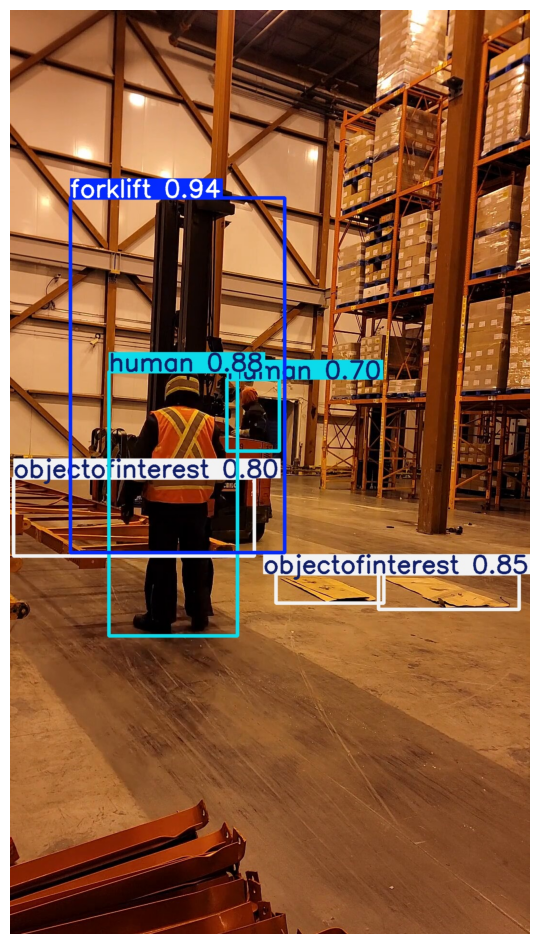

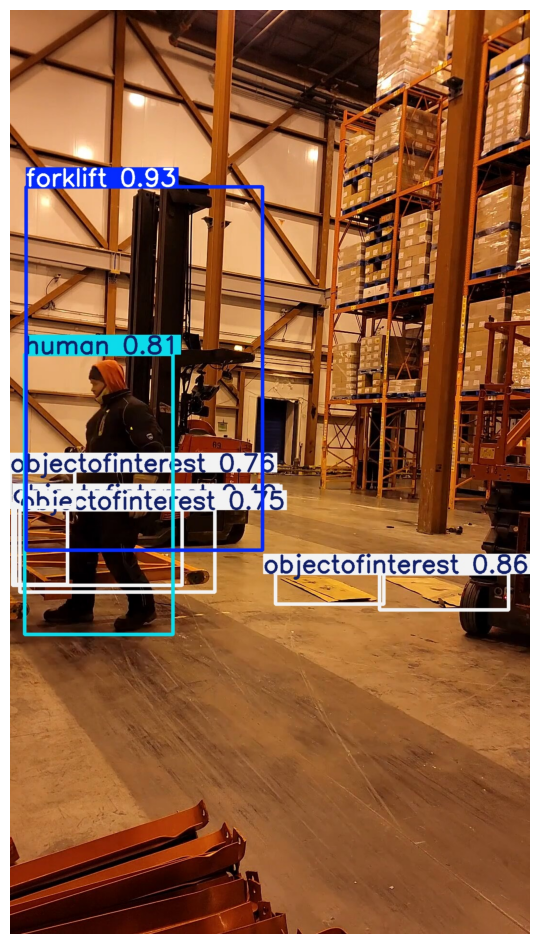

In [ ]:
folder = f"/content/matrix-assessment/runs/detect/predict-full_set"

list_of_images = [
    'pexels-rolan-muradov-15170997 (1080p)_175.jpg',
    'pexels-rolan-muradov-15170997 (1080p)_191.jpg'
]

images = []
for image_str in list_of_images:
  sv.plot_image(image=cv2.imread(f'{folder}/{image_str}'))

### Plotly interactive plots of various forklift properties
Interactive Plotly plots are crucial for effectively showcasing significant changes and identifying potential dangers in forklift operations. They offer a dynamic and user-friendly way to visualize complex data, turning it into clear, interactive graphics that make trends and anomalies easy to spot. With features like zooming, panning, and real-time data exploration, these plots allow one to delve deeply into specific incidents and movements, providing a more detailed understanding of the forklift's behavior. This interactive approach not only highlights critical moments but also helps in quickly pinpointing potential safety issues or operational inefficiencies, facilitating a more responsive and informed decision-making process.

In [ ]:
# Convert metrics to DataFrame for Plotly Express
timestamp_list = timestamps[:]
area_list = metrics['areas']
depths_list = metrics['depths']
aspect_ratios_list = metrics['aspect_ratios']
speed_list = [0] + metrics['speed']
acceleration_list = [0] + metrics['acceleration'] + [0]
area_changes = [0] + metrics['area_changes']

df = pd.DataFrame({
    'Time': timestamp_list,
    'Area': area_list,
    'Aspect Ratio': aspect_ratios_list,
    'Speed': speed_list,
    'Acceleration': acceleration_list,
    'Depth': depths_list,
    'Area Changes': area_changes
})

# Plot Absolute Areas Size over Time
fig_area = px.scatter(df, x='Time', y='Area', title='Areas over Time', labels={'Time': 'Time (s)', 'Area': 'Area (px^2)'})
fig_area.show()

### Area over Time
The area over time plot helps describe the relative size of the forklift's bounding box across all 227 frames. As explained before we can see the relative size of the forklift at `frame 0` is slightly smaller than the size of the forklift at the end of the frame sequence. This matches up well with the image data. Additionally, if we look at the larges and smallest areas, `frame 51` and `frame 100` respectively, we can see it matches very well to the image data (see above).

In [ ]:
# Plot Change in Areas Size over Time
fig_area = px.scatter(df, x='Time', y='Area Changes', title='Changes in Areas over Time', labels={'Time': 'Time (s)', 'Change in Area': 'Area (px^2)'})
fig_area.show()

### Changes in Areas over Time
The results of this graph are somewhat more obscure but it could be assumed that the largest changes in areas are ones where the camera misses a transition between successive frames.

In [ ]:
# Plot Aspect Ratio over Time
fig_aspect_ratio = px.scatter(df, x='Time', y='Aspect Ratio', title='Aspect Ratio over Time', labels={'Time': 'Time (s)', 'Aspect Ratio': 'Aspect ratio (unitless)'})
fig_aspect_ratio.show()

### Aspect ratio over Time
Large changes in an aspect ratio over time in a graph can be quite telling about the forklift's movement and positioning. When you see significant fluctuations in the aspect ratio—essentially the ratio of width to height of the bounding box—this might indicate that the forklift is rotating or changing its orientation relative to the camera. For instance, a sudden shift could suggest that the forklift is turning sharply or maneuvering in a way that alters its perceived shape. Such changes might be harmless, but they could also signal problematic behavior, like awkward turns or misalignments that could affect the forklift's stability or precision.

In [ ]:
# Prepare data for trajectory plot
trajectory_df = pd.DataFrame({
    'X': [centroid[0] for centroid in metrics['centroids']],
    'Y': [centroid[1] for centroid in metrics['centroids']],
    'Time': timestamps
})

# Plot Trajectory
trajectory_df.sort_values(by="Time")
fig_trajectory = px.line(trajectory_df, x='X', y='Y', title='Forklift Movement Trajectory', labels={'X': 'X Coordinate', 'Y': 'Y Coordinate'}, hover_data=['X', 'Y', 'Time'])
fig_trajectory.update_xaxes(range=(0,1079))
fig_trajectory.show()

### Forklift movement trajectory
The graph of the trajectory of the forklift gives an excellent example of the "movement within the scene" of the object. We can see that in much the same way as the images the forklift starts on the far right of the image, moves towards the far left and then comes towards and away from the camera. This movement matches what is observed in the image data.

In [ ]:
# Plot Speed over Time
fig_speed = px.line(df, x='Time', y='Speed', title='Forklift Speed over Time', labels={'Time': 'Time (s)', 'Speed': 'Speed (units/s)'})
fig_speed.add_vrect(x0=93, x1=103,
              annotation_text="Significant relative<br>change in speed", annotation_position="top right",
              annotation_font_size=11,
              annotation_font_color="Blue",
              fillcolor="yellow", opacity=0.25, line_width=0)
fig_speed.add_vrect(x0=132, x1=140,
              annotation_text="Significant relative<br>change in speed", annotation_position="top right",
              annotation_font_size=11,
              annotation_font_color="Blue",
              fillcolor="yellow", opacity=0.25, line_width=0)
fig_speed.add_vrect(x0=199, x1=203,
              annotation_text="Significant relative<br>change in speed", annotation_position="top right",
              annotation_font_size=11,
              annotation_font_color="Blue",
              fillcolor="yellow", opacity=0.25, line_width=0)
fig_speed.show()

# Plot Acceleration over Time
fig_acceleration = px.line(df, x='Time', y='Acceleration', title='Forklift Acceleration over Time', labels={'Time': 'Time (s)', 'Acceleration': 'Acceleration (units/s/s)'})
fig_acceleration.add_hrect(y0=-105, y1=-1,
              annotation_text="Negative (reverse)<br>acceleration", annotation_position="bottom right",
              annotation_font_size=11,
              annotation_font_color="Black",
              fillcolor="red", opacity=0.25, line_width=0)
fig_acceleration.add_hrect(y0=1, y1=125,
              annotation_text="Positive (forward)<br>acceleration", annotation_position="top right",
              annotation_font_size=11,
              annotation_font_color="Black",
              fillcolor="green", opacity=0.25, line_width=0)
fig_acceleration.show()

### Speed and acceleration over time
The above two graphs indicate the most telling movements of the forklift. The speed over time graph shows relative movement of the centroids of the bounding box across frames. Large changes in speed could indicate large distances covered by the forklift. Acceleration shows the same data but with an added piece of information - direction.

At `frame 100` we see a large change in speed which appears that the forklift is accelerating _away_ from the camera. Conversely, the large changes in speed at `frame 134` and `frame 199` indicate the _towards_ the camera.

# 3D Graphing

To visualize the bounding boxes in 3D space using `plotly`, we can add a depth (z-axis) component based on the area of the bounding box, assuming that the area is inversely correlated to the distance from the camera. This means that larger bounding boxes are closer to the camera, and smaller ones are farther away.


### Explanation:

1. **Bounding Box Depth Calculation**:
   - The depth (z-axis) is calculated using the `area_to_depth` function, which assumes an inverse correlation between the area of the bounding box and the distance from the camera.

2. **3D Plot with Plotly**:
   - `go.Scatter3d` is used to plot both the bounding boxes and the centroids in 3D space.
   - The front face of each bounding box is plotted at the calculated depth, and the centroid of each bounding box is represented by a red marker.

3. **Visualization**:
   - The plot will show the bounding boxes in 3D space with their depths determined by their areas. Larger bounding boxes (closer objects) will appear nearer to the camera, while smaller ones (farther objects) will appear deeper in the 3D space.

4. **Customization**:
   - You can adjust the `scale` parameter in the `area_to_depth` function to better fit the depth calculation to your specific case.

This visualization provides a clear way to see the relative position and depth of the forklift as it moves in 3D space.

In [ ]:
def cubes_xy(size_x, size_y, depth_z, pos_x, pos_y, pos_z, color, label):
    # create points
    x, y, z = np.meshgrid(
        np.linspace(pos_x-size_x/2, pos_x+size_x/2, 2),
        np.linspace(pos_y-size_y/2, pos_y+size_y/2, 2),
        np.linspace(depth_z, depth_z+1000, 2),
    )
    x = x.flatten()
    y = y.flatten()
    z = z.flatten()

    return go.Mesh3d(
        x=x, y=y, z=z, alphahull=1, flatshading=True,
        color=color,
        lighting={'diffuse': 0.1, 'specular': 2.0, 'roughness': 0.5},
        text=label)

def cubes_scene(size_x, size_y, depth_z, pos_x, pos_y, pos_z, color):
    # create points
    x, y, z = np.meshgrid(
        np.linspace(0, size_x, 2),
        np.linspace(0, size_y, 2),
        np.linspace(0, depth_z, 2),
    )
    x = x.flatten()
    y = y.flatten()
    z = z.flatten()

    return go.Mesh3d(
        x=x, y=y, z=z, alphahull=1, flatshading=True,
        color=color,
        lighting={'diffuse': 0.1, 'specular': 2.0, 'roughness': 0.5},
    )

bounding_boxes = forklift_dict['bounding_boxes']

size = 5
scale = 100000

select_ids = [
    50, # The closest approach of the forklift
    100 # The furtherest approach of the forklift
]
bounding_boxes_temp = []
for index, item in enumerate(bounding_boxes):
  if index in select_ids:
    bounding_boxes_temp.append(item)

fig = go.Figure()
fig.add_trace(cubes_scene(1080,1920,10000,0,0,0,'rgba(255,100,0,0.1)'))

for i, bbox in enumerate(bounding_boxes_temp):

    depth = metrics['depths'][i]
    label = f"Image index: {select_ids[i]}"
    x_min, y_min, x_max, y_max = bbox

    # set edge length of cubes
    size_x = x_max - x_min
    size_y = y_max - y_min
    depth_z = (depth * scale)

    # Differentiate
    if i == 0:
      depth_z = depth_z * 6
    else:
      depth_z = 0

    # add inner center cube
    fig.add_trace(cubes_xy(size_x, size_y, depth_z, x_min,y_min,0, 'rgba(100,0,100,0.1)', label=label))

camera = dict(
    eye=dict(x=1.2, y=1.5, z=0.3)
)

fig.update_layout(scene_camera=camera, title=name)

fig.show()

### Compared to the actual size of the forklift

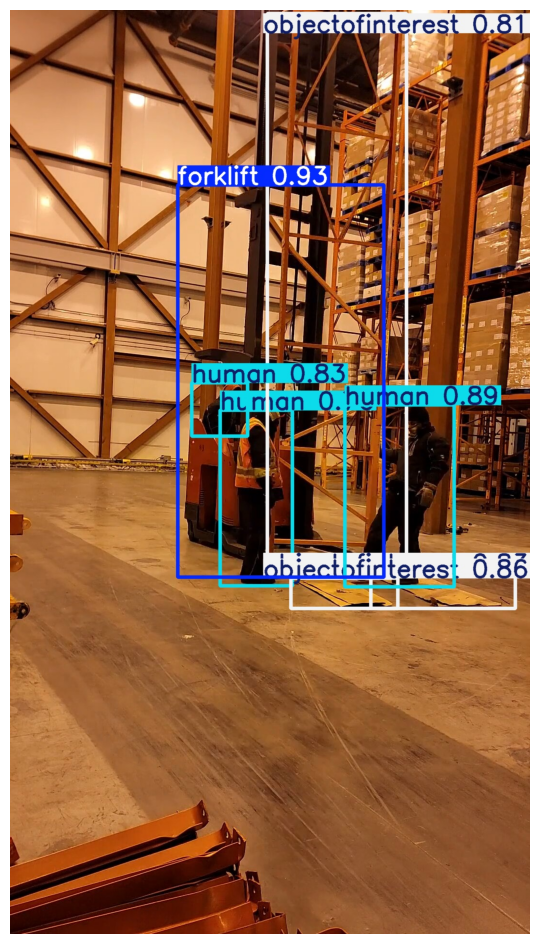

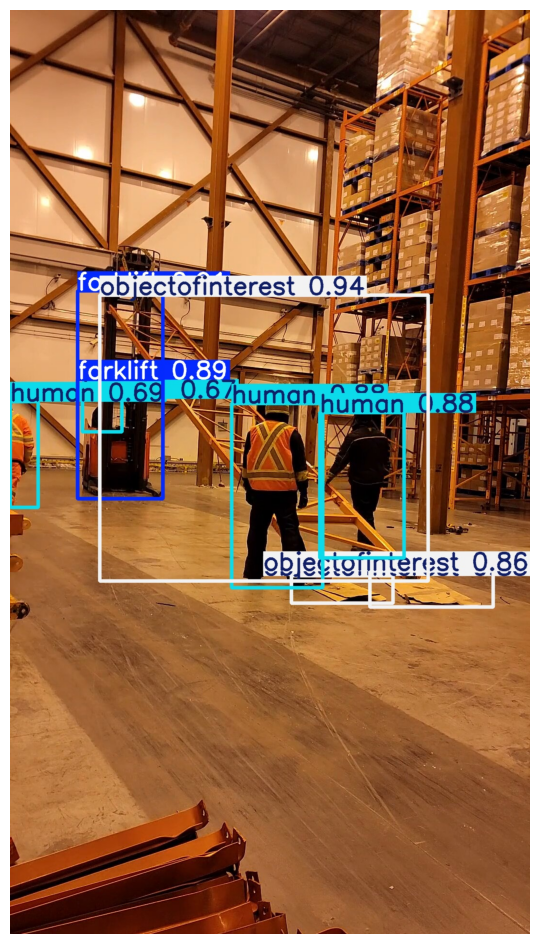

In [ ]:
folder = f"/content/matrix-assessment/runs/detect/predict-full_set"

list_of_images = [
    'pexels-rolan-muradov-15170997 (1080p)_050.jpg',
    'pexels-rolan-muradov-15170997 (1080p)_100.jpg',
]

images = []
for image_str in list_of_images:
  sv.plot_image(image=cv2.imread(f'{folder}/{image_str}'))

### Discussion on the visualisation of the bounding boxes in 3D space

There was some difficulty in getting the bounding boxes to look similar to the actual scene, both in terms of scale and relative positioning of the boxes. The data presented here is a crude approximation of the sizes given the inverse relationship shown and a manual placement of the 2D bounding boxes in boxes in space.

# Conclusion

Going from a list of 227 images to the absolute overwhelming amount of data within the given time frame has been a fufilling and rewarding experience. I have re-affirmed my believe that for quick, once-off cases YOLOv8 provides an easy-to-use, quick-to-get-started framework. The recent change to AGPL is somewhat restricting but the overall idea behind the framework made the work shown here possible. In summary, a lot of detail can be garnered from a small number of images if you look hard enough and this has shown that even with a relatively small dataset one can get to convicing results.

# BONUS QUESTION: Count the number of forklifts and persons in the scene.

image count: 70


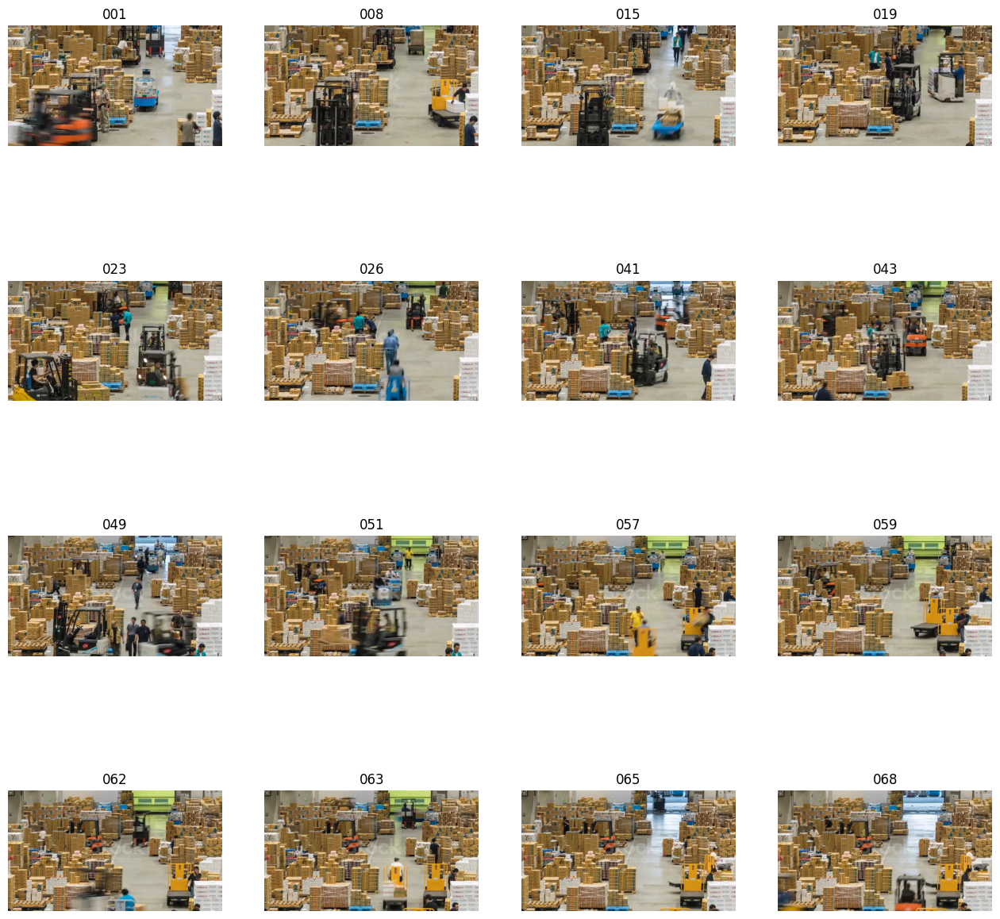

In [ ]:
from random import sample

IMAGE_DIR_PATH = f"{HOME}/matrix-assessment/dataset_bonus"
SAMPLE_SIZE = 16
SAMPLE_GRID_SIZE = (4, 4)
SAMPLE_PLOT_SIZE = (16, 16)

image_paths = sv.list_files_with_extensions(
    directory=IMAGE_DIR_PATH,
    extensions=["jpg"])

print('image count:', len(image_paths))

image_paths = sorted(image_paths)

image_paths_sampled = sample(image_paths,SAMPLE_SIZE)
image_paths_sampled = sorted(image_paths_sampled)

titles = []
images = []
for image_path in image_paths_sampled:
  titles.append(image_path.stem[-3:])
  images.append(cv2.imread(str(image_path)))

sv.plot_images_grid(images=images, titles=titles, grid_size=SAMPLE_GRID_SIZE, size=SAMPLE_PLOT_SIZE)

In [ ]:
import cv2
from ultralytics import YOLO, solutions
from collections import defaultdict

model = YOLO("yolov8s.pt")

# Define line points
region_points = [(0, 130), (620, 130), (0, 180), (620, 180)]

# Init Object Counter
counter = solutions.ObjectCounter(
    view_img=True,
    reg_pts=region_points,
    names=model.names,
    draw_tracks=True,
    line_thickness=2,
)

class_counts = defaultdict(list)

for image_path in image_paths:
  image = cv2.imread(str(image_path))
  results = model.track(image, persist=True, show=False, verbose=True)
  image = counter.start_counting(image, results)

  for r in results:
    ids = []
    classes = []
    if r.boxes.id is not None:
      ids = r.boxes.id.tolist()
    if r.boxes.cls is not None:
      classes = r.boxes.cls.tolist()

    for id, class_id in zip(ids, classes):
      class_counts[id].append(class_id)

sum = 0
for k, v in class_counts.items():
  sum = sum + len(v)

print("----------------------")
print(f"The detector identified {sum} humans.")
print("----------------------")

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

Polygon Counter Initiated.

0: 384x640 3 persons, 319.3ms
Speed: 3.8ms preprocess, 319.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 335.8ms
Speed: 2.6ms preprocess, 335.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 343.4ms
Speed: 1.9ms preprocess, 343.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 323.2ms
Speed: 2.5ms preprocess, 323.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 person, 320.4ms
Speed: 1.8ms preprocess, 320.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 334.1ms
Speed: 2.4ms preprocess, 334.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 persons, 351.3ms
Speed: 2.6ms preprocess, 351.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 64

In [ ]:
BEST_MODEL = '/content/matrix-assessment/best/weights/best.pt'

model = YOLO(BEST_MODEL)

# Define line points
region_points = [(0, 130), (620, 130), (0, 180), (620, 180)]

# Init Object Counter
counter = solutions.ObjectCounter(
    view_img=True,
    reg_pts=region_points,
    names=model.names,
    draw_tracks=True,
    line_thickness=2,
)

class_counts = defaultdict(list)
class_counts_x = defaultdict(list)

counter_val = 0
for image_path in image_paths:
  image = cv2.imread(str(image_path))
  results = model.track(image, persist=True, show=False, verbose=True)
  image = counter.start_counting(image, results)

  for r in results:
    ids = []
    classes = []
    if r.boxes.id is not None:
      ids = r.boxes.id.tolist()
    if r.boxes.cls is not None:
      classes = r.boxes.cls.tolist()

    if len(ids) > 0:
      for id, class_id in zip(ids, classes):
        class_counts[class_id].append(id)
    else:
      for class_id in classes:
        class_counts[class_id].append(99)

print("----------------------")
print(f"The detector identified {len(class_counts[1])} humans.")
print(f"The detector identified {len(class_counts[0])} forklifts.")
print("----------------------")

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

Polygon Counter Initiated.

0: 384x640 2 humans, 336.3ms
Speed: 3.1ms preprocess, 336.3ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 human, 317.1ms
Speed: 2.5ms preprocess, 317.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 human, 311.6ms
Speed: 1.9ms preprocess, 311.6ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 forklift, 3 humans, 336.5ms
Speed: 1.8ms preprocess, 336.5ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 forklift, 2 humans, 313.2ms
Speed: 1.8ms preprocess, 313.2ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 humans, 321.9ms
Speed: 2.5ms preprocess, 321.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 3 humans, 314.1ms
Speed: 2.4ms preprocess, 314.1ms inference, 0.8ms postprocess per image at shap

# Conclusion
The results here from both the pre-trained small model and the fine-tuned model used in the previous questions does not perform too well. My assumption is that a) the pre-trained model does not necessarily have enough forklift data in it to identify the forklifts from this angle. The fine-tuned model, on the other hand, only had one example of the forklifts and cannot reasonably be expected to identify other types of forklifts without far more training data.

Also the tracking id method use in YOLOv8, namely [BoT-SORT](https://github.com/NirAharon/BoT-SORT), is state of the art but it is unclear if my usage of it here is the correct one. Given more time I'd investigate if the tracking ids do match across the frames correctly and implement a more intelligent counting system.